<a href="https://colab.research.google.com/github/Villermo95/Survey_Forthcoming/blob/main/Survey.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install contextily

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 18.5 MB/s eta 0:00:00


In [2]:
!pip install seaborn  # Install the seaborn library

In [3]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Polygon
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D # Import Line2D here
import os  # Import the os module at the beginning of the script
import contextily as ctx
import numpy as np
from matplotlib import cm
from matplotlib.colors import Normalize
from google.colab import drive
import seaborn as sns
drive.mount('/content/drive')
import numpy as np
from matplotlib import cm
from matplotlib.colors import Normalize
from google.colab import drive
import seaborn as sns  # Import seaborn
from openpyxl import Workbook
from openpyxl.utils.dataframe import dataframe_to_rows
from openpyxl.drawing.image import Image
import io

Mounted at /content/drive


In [4]:
# Leer los shapefiles G:\Mi unidad\PhD\Regreeneration\VilaFranca
VFX_barder = gpd.read_file("/content/drive/MyDrive/PhD/Regreeneration/VilaFranca/VFX_4326/VFX_4326_Border.shp")
VFX_Zones = gpd.read_file("/content/drive/MyDrive/PhD/Regreeneration/Area/VFX_Zones_city.shp")
Bufers = gpd.read_file("/content/drive/MyDrive/PhD/Survey/VFX_buffer/vfx_buffer.shp")
new_density = gpd.read_file("/content/drive/MyDrive/PhD/Survey/VFX_buffer/subsec_density selection.shp")
# Ruta al archivo GPKG en Google Drive
ruta_gpkg = "/content/drive/MyDrive/PhD/BGRI21_LISBOA/BGRI21_LISBOA.gpkg"

# Leer una capa diferente del GPKG
VFX_pob = gpd.read_file(ruta_gpkg, layer='VFX_BGRI_21')  # Replace 'new_layer_name'

# Verificar que se leyó correctamente
print(VFX_pob.head())

   OBJECTID     BGRI2021 DT21 DTMN21 DTMNFR21 DTMNFRSEC21 SECNUM21 SSNUM21  \
0     45630  11140800103   11   1114   111408   111408001      001      03   
1     45631  11141502704   11   1114   111415   111415027      027      04   
2     45632  11141502705   11   1114   111415   111415027      027      05   
3     45129  11141300707   11   1114   111413   111413007      007      07   
4     45130  11141300708   11   1114   111413   111413007      007      08   

  SECSSNUM21    SUBSECCAO  ... N_INDIVIDUOS N_INDIVIDUOS_H N_INDIVIDUOS_M  \
0      00103  11140800103  ...         30.0           16.0           14.0   
1      02704  11141502704  ...        556.0          266.0          290.0   
2      02705  11141502705  ...         79.0           36.0           43.0   
3      00707  11141300707  ...         18.0           11.0            7.0   
4      00708  11141300708  ...          8.0            5.0            3.0   

   N_INDIVIDUOS_0_14  N_INDIVIDUOS_15_24  N_INDIVIDUOS_25_64  \
0   

In [5]:
Bufers=Bufers.to_crs(epsg=3857)
new_density=new_density.to_crs(epsg=3857)

In [6]:
# prompt: A Bufers crear un geodataframe que se llame Points con los centroides

# Assuming the code you provided is already executed and the 'Bufers' GeoDataFrame is available.

# Create a new GeoDataFrame 'Points' with centroids of the polygons in 'Bufers'
Points = Bufers.copy()  # Create a copy to avoid modifying the original GeoDataFrame
Points['geometry'] = Points['geometry'].centroid

# Print the first few rows of the new GeoDataFrame to verify
print(Points.head())


   BUFF_DIST  ORIG_FID   Shape_Leng    Shape_Area  \
0      800.0         1  5026.548246  2.010619e+06   
1      800.0         2  5026.548246  2.010619e+06   
2      800.0         3  5026.548246  2.010619e+06   
3      800.0         4  5026.548246  2.010619e+06   
4      800.0        12  5026.548246  2.010619e+06   

                           geometry  
0   POINT (-998852.347 4720913.672)  
1   POINT (-1001268.697 4715443.39)  
2  POINT (-1000065.996 4717445.635)  
3  POINT (-1003105.153 4711723.011)  
4  POINT (-1010917.275 4703762.232)  


In [7]:
VFX_barder.to_crs(epsg=3857)

,fid_1,DICO,Municipio,Distrito,N_Freguesi,NUTSIII,NUTSII,NUTSI,Alt_Max,Alt_Min,Area_ha,Perim_km,geometry
0,160.0,1114,Vila Franca de Xira,Lisboa,6.0,Grande Lisboa,Grande Lisboa,Continente,378.0,0.0,31819.39,137.0,"POLYGON ((-987784.009 4725924.355, -987772.369..."


In [8]:
VFX=VFX_Zones.to_crs(epsg=3857)

In [9]:
VFX_P=VFX_pob.to_crs(epsg=3857)
Points=Points.to_crs(epsg=3857)

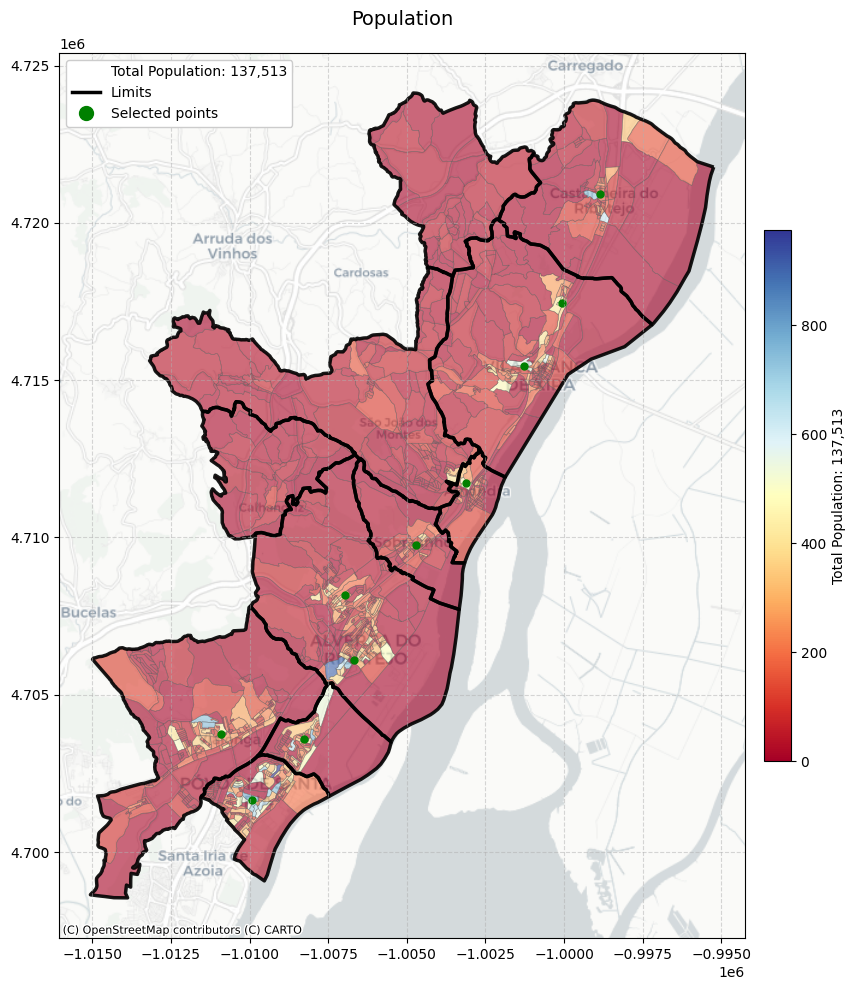

In [ ]:
# Create figure
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Graphing main data
total_pob = VFX_P['N_INDIVIDUOS'].sum() if 'N_INDIVIDUOS' in VFX_pob.columns else 0

VFX_P.plot(column='N_INDIVIDUOS', cmap='RdYlBu',
                             legend=True, ax=ax,
                             alpha=0.6,
                             linewidth=0.4,
                             edgecolor='0.4',
                             legend_kwds={
                                 'label': f'Total Population: {int(total_pob):,}',
                                 'shrink': 0.6,
                                 'orientation': 'vertical',
                                 'pad': 0.02
                                 })

# Add the 'int_area' shapefile with a wide black border and transparent fill
VFX.plot(ax=ax,
              color='none',  # transparent fill
              edgecolor='black',  # black border
              linewidth=2.5,  # wide border
              alpha=0.9)  # Border transparency

# 3. Points layer (with customization)
if Points is not None and isinstance(Points, gpd.GeoDataFrame):
   Points.plot(ax=ax,
             color='green',
             markersize=25,
             marker='o',
             alpha=1,
             label='Related Points')

# Add basemap
ctx.add_basemap(ax, crs=VFX_P.crs.to_string(), source=ctx.providers.CartoDB.Positron)

# Unified legend with total population
legend_elements = []

# Añadir elemento de población total (solo si existe)
if 'N_INDIVIDUOS' in VFX_P.columns:
    legend_elements.append(
        Line2D([0], [0], color='white', lw=0,  # Elemento invisible
              label=f'Total Population: {int(total_pob):,}'))
if VFX is not None:
    legend_elements.append(
        Line2D([0], [0], color='black', lw=2.5,
              label='Limits'))

if Points is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Selected points',
              markerfacecolor='green',
              markersize=10,
              linestyle='None'))

if legend_elements:
    ax.legend(handles=legend_elements,
             loc='upper left',
            framealpha=1)

# Title and layout
#plt.title(title, fontsize=14, pad=20)
plt.tight_layout()

# Additional settings
ax.set_title("Population", fontsize=14, pad=20)
ax.grid(True, linestyle='--', alpha=0.5)

# Add legend for the intervention area
from matplotlib.lines import Line2D
#legend_elements = [Line2D([0], [0], color='black', lw=2.5, label='Area of ​​Intervention')]
#ax.legend(handles=legend_elements, loc='upper right')

plt.tight_layout()
plt.show()

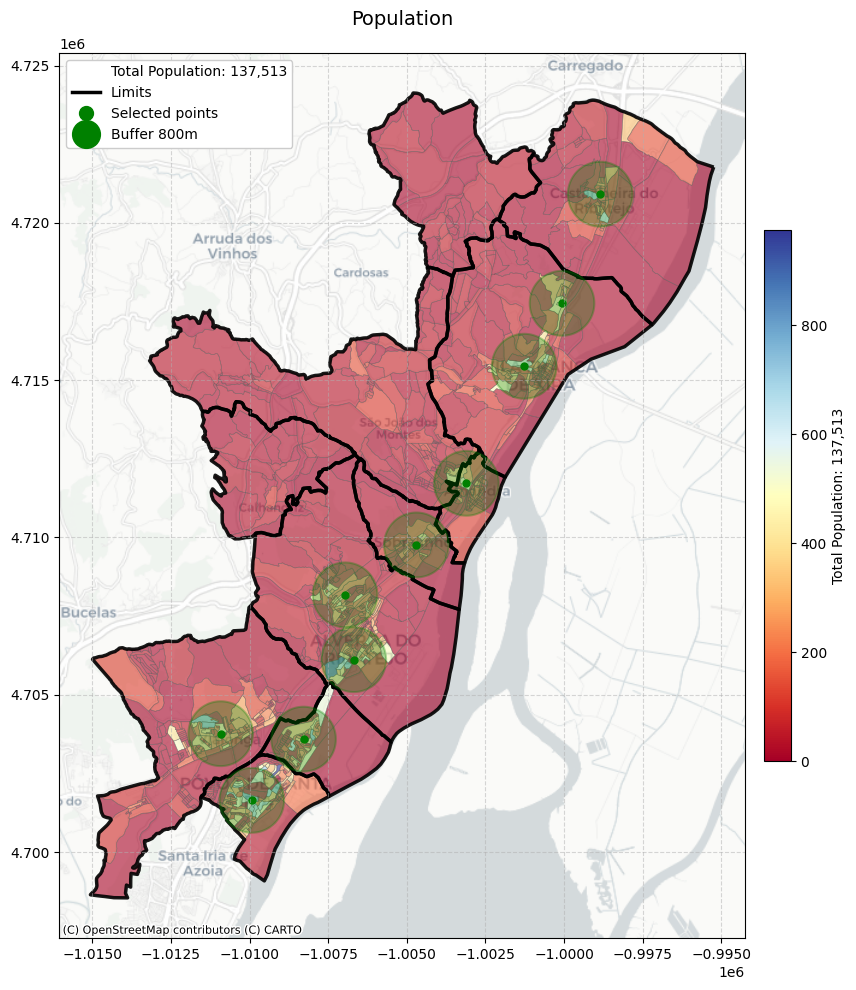

In [ ]:
# Create figure
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Graphing main data
total_pob = VFX_P['N_INDIVIDUOS'].sum() if 'N_INDIVIDUOS' in VFX_pob.columns else 0

VFX_P.plot(column='N_INDIVIDUOS', cmap='RdYlBu',
                             legend=True, ax=ax,
                             alpha=0.6,
                             linewidth=0.4,
                             edgecolor='0.4',
                             legend_kwds={
                                 'label': f'Total Population: {int(total_pob):,}',
                                 'shrink': 0.6,
                                 'orientation': 'vertical',
                                 'pad': 0.02
                                 })

# Add the 'int_area' shapefile with a wide black border and transparent fill
VFX.plot(ax=ax,
              color='none',  # transparent fill
              edgecolor='black',  # black border
              linewidth=2.5,  # wide border
              alpha=0.9)  # Border transparency

Bufers.plot(ax=ax,
              color='green',  # transparent fill
              edgecolor='green',  # black border
              linewidth=1.5,  # wide border
              alpha=0.3)  # Border transparency

# 3. Points layer (with customization)
if Points is not None and isinstance(Points, gpd.GeoDataFrame):
   Points.plot(ax=ax,
             color='green',
             markersize=25,
             marker='o',
             alpha=1,
             label='Related Points')

# Add basemap
ctx.add_basemap(ax, crs=VFX_P.crs.to_string(), source=ctx.providers.CartoDB.Positron)

# Unified legend with total population
legend_elements = []

# Añadir elemento de población total (solo si existe)
if 'N_INDIVIDUOS' in VFX_P.columns:
    legend_elements.append(
        Line2D([0], [0], color='white', lw=0,  # Elemento invisible
              label=f'Total Population: {int(total_pob):,}'))
if VFX is not None:
    legend_elements.append(
        Line2D([0], [0], color='black', lw=2.5,
              label='Limits'))

if Points is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Selected points',
              markerfacecolor='green',
              markersize=10,
              linestyle='None'))
if Bufers is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Buffer 800m',
              markerfacecolor='green',
              markersize=20,
              linestyle='None'))

if legend_elements:
    ax.legend(handles=legend_elements,
             loc='upper left',
            framealpha=1)

# Title and layout
#plt.title(title, fontsize=14, pad=20)
plt.tight_layout()

# Additional settings
ax.set_title("Population", fontsize=14, pad=20)
ax.grid(True, linestyle='--', alpha=0.5)

# Add legend for the intervention area
from matplotlib.lines import Line2D
#legend_elements = [Line2D([0], [0], color='black', lw=2.5, label='Area of ​​Intervention')]
#ax.legend(handles=legend_elements, loc='upper right')

plt.tight_layout()
plt.show()

In [10]:
new_density.columns

Index(['OBJECTID_1', 'BGRI2021', 'DT21', 'DTMN21', 'DTMNFR21', 'DTMNFRSEC2',
       'SECNUM21', 'SSNUM21', 'SECSSNUM21', 'SUBSECCAO', 'NUTS1', 'NUTS2',
       'NUTS3', 'N_EDIFICIO', 'N_EDIFIC_1', 'N_EDIFIC_2', 'N_EDIFIC_3',
       'N_EDIFIC_4', 'N_EDIFIC_5', 'N_EDIFIC_6', 'N_EDIFIC_7', 'N_EDIFIC_8',
       'N_EDIFIC_9', 'N_EDIFI_10', 'N_EDIFI_11', 'N_ALOJAMEN', 'N_ALOJAM_1',
       'N_ALOJAM_2', 'N_ALOJAM_3', 'N_RHABITUA', 'N_RHABIT_1', 'N_RHABIT_2',
       'N_RHABIT_3', 'N_AGREGADO', 'N_ADP_1_OU', 'N_ADP_3_OU', 'N_NUCLEOS_',
       'N_NUCLEOS1', 'N_INDIVIDU', 'N_INDIVI_1', 'N_INDIVI_2', 'N_INDIVI_3',
       'N_INDIVI_4', 'N_INDIVI_5', 'N_INDIVI_6', 'AREA_KM2', 'POP_DENS',
       'Shape_Leng', 'Shape_Area', 'geometry'],
      dtype='object')

In [11]:
# prompt: crea una nueva columna en VFX_P llamada density = N_INDIVIDUOS/AREA esta area esta en km2 pero la quiero en hab/hec
VFX_P=VFX_P.to_crs(epsg=3763)
# Calculate area in square meters
AREA=VFX_P.geometry.area/1000000
VFX_P['AREA']=AREA
# Calculate density in hab/km²
VFX_P['density_km2'] = VFX_P['N_INDIVIDUOS'] / VFX_P['AREA']

# Convert area from km² to hectares (1 km² = 100 hectares)
VFX_P['AREA_ha'] = VFX_P['AREA'] * 100

# Calculate density in hab/hectare
VFX_P['density_ha'] = VFX_P['N_INDIVIDUOS'] / VFX_P['AREA_ha']


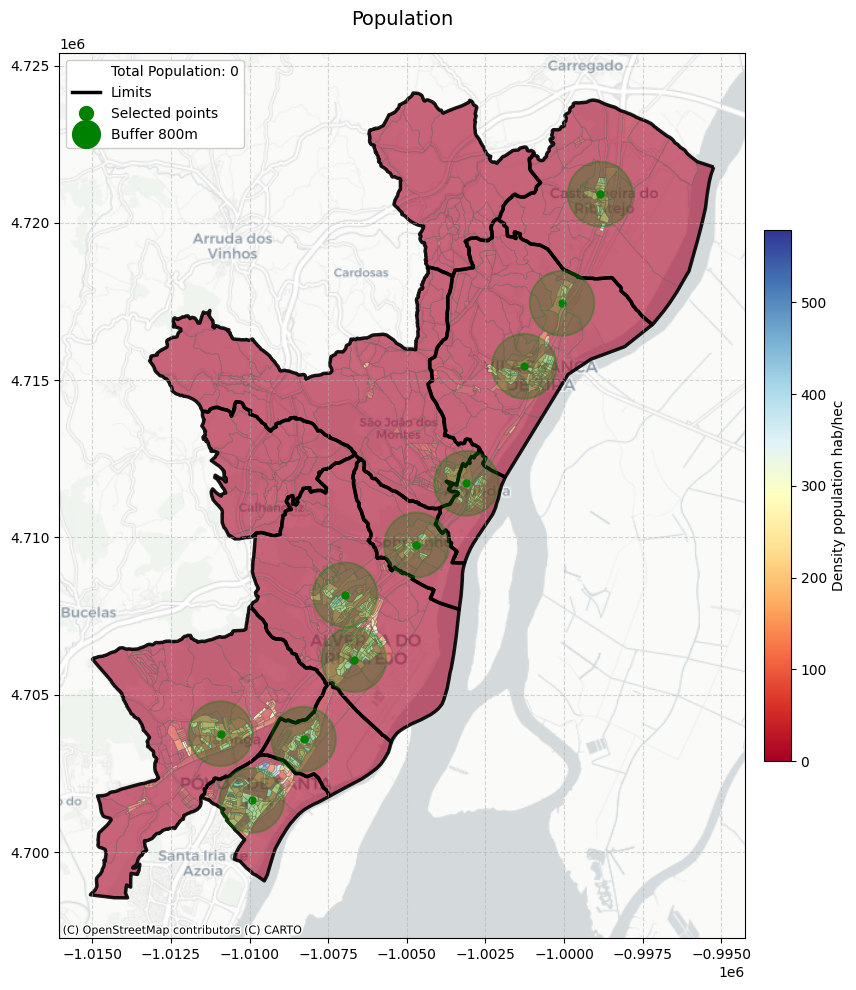

In [15]:
VFX_P=VFX_P.to_crs(epsg=3857)
# Create figure
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Graphing main data
total_pob = VFX_P['density_ha'].sum() if 'density_ha' in VFX_pob.columns else 0

VFX_P.plot(column='density_ha', cmap='RdYlBu',
                             legend=True, ax=ax,
                             alpha=0.6,
                             linewidth=0.4,
                             edgecolor='0.4',
                             legend_kwds={
                                 'label': "Density population hab/hec",
                                 'shrink': 0.6,
                                 'orientation': 'vertical',
                                 'pad': 0.02
                                 })

# Add the 'int_area' shapefile with a wide black border and transparent fill
VFX.plot(ax=ax,
              color='none',  # transparent fill
              edgecolor='black',  # black border
              linewidth=2.5,  # wide border
              alpha=0.9)  # Border transparency

Bufers.plot(ax=ax,
              color='green',  # transparent fill
              edgecolor='green',  # black border
              linewidth=1.5,  # wide border
              alpha=0.3)  # Border transparency

# 3. Points layer (with customization)
if Points is not None and isinstance(Points, gpd.GeoDataFrame):
   Points.plot(ax=ax,
             color='green',
             markersize=25,
             marker='o',
             alpha=1,
             label='Related Points')

# Add basemap
ctx.add_basemap(ax, crs=VFX_P.crs.to_string(), source=ctx.providers.CartoDB.Positron)

# Unified legend with total population
legend_elements = []

# Añadir elemento de población total (solo si existe)
if 'N_INDIVIDUOS' in VFX_P.columns:
    legend_elements.append(
        Line2D([0], [0], color='white', lw=0,  # Elemento invisible
              label=f'Total Population: {int(total_pob):,}'))
if VFX is not None:
    legend_elements.append(
        Line2D([0], [0], color='black', lw=2.5,
              label='Limits'))

if Points is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Selected points',
              markerfacecolor='green',
              markersize=10,
              linestyle='None'))
if Bufers is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Buffer 800m',
              markerfacecolor='green',
              markersize=20,
              linestyle='None'))

if legend_elements:
    ax.legend(handles=legend_elements,
             loc='upper left',
            framealpha=1)

# Title and layout
#plt.title(title, fontsize=14, pad=20)
plt.tight_layout()

# Additional settings
ax.set_title("Population", fontsize=14, pad=20)
ax.grid(True, linestyle='--', alpha=0.5)

# Add legend for the intervention area
from matplotlib.lines import Line2D
#legend_elements = [Line2D([0], [0], color='black', lw=2.5, label='Area of ​​Intervention')]
#ax.legend(handles=legend_elements, loc='upper right')

plt.tight_layout()
plt.show()

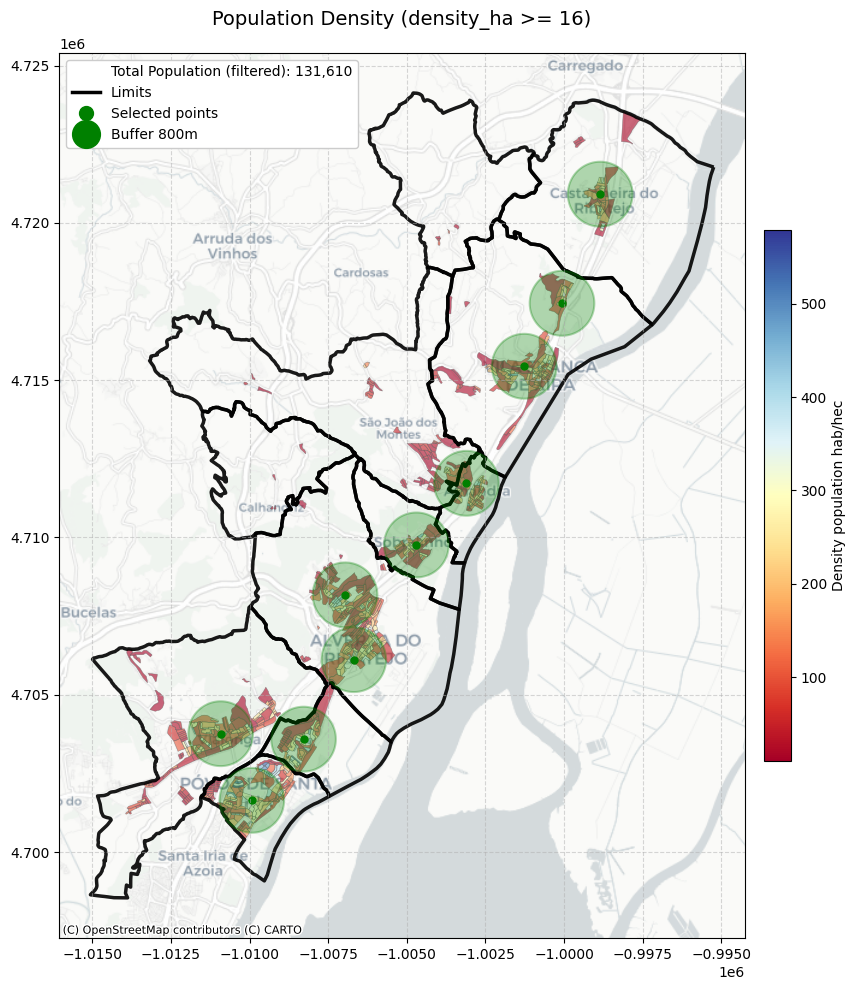

In [16]:
# prompt: para el anterior quita las areas que tengan el field density _ha menor a 16 y vuelve a hacer el mismo mapa anterior

# Filter out areas with density_ha less than 16
VFX_P_filtered = VFX_P[VFX_P['density_ha'] >= 10]

# Create figure
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Graphing main data
total_pob_filtered = VFX_P_filtered['density_ha'].sum() if 'density_ha' in VFX_P_filtered.columns else 0

VFX_P_filtered.plot(column='density_ha', cmap='RdYlBu',
                             legend=True, ax=ax,
                             alpha=0.6,
                             linewidth=0.4,
                             edgecolor='0.4',
                             legend_kwds={
                                 'label': "Density population hab/hec",
                                 'shrink': 0.6,
                                 'orientation': 'vertical',
                                 'pad': 0.02
                                 })

# Add the 'int_area' shapefile with a wide black border and transparent fill
VFX.plot(ax=ax,
              color='none',  # transparent fill
              edgecolor='black',  # black border
              linewidth=2.5,  # wide border
              alpha=0.9)  # Border transparency

Bufers.plot(ax=ax,
              color='green',  # transparent fill
              edgecolor='green',  # black border
              linewidth=1.5,  # wide border
              alpha=0.3)  # Border transparency

# 3. Points layer (with customization)
if Points is not None and isinstance(Points, gpd.GeoDataFrame):
   Points.plot(ax=ax,
             color='green',
             markersize=25,
             marker='o',
             alpha=1,
             label='Related Points')

# Add basemap
ctx.add_basemap(ax, crs=VFX_P_filtered.crs.to_string(), source=ctx.providers.CartoDB.Positron)

# Unified legend with total population
legend_elements = []

# Añadir elemento de población total (solo si existe)
legend_elements.append(
    Line2D([0], [0], color='white', lw=0,  # Elemento invisible
            label=f'Total Population (filtered): {int(total_pob_filtered):,}'))

if VFX is not None:
    legend_elements.append(
        Line2D([0], [0], color='black', lw=2.5,
              label='Limits'))

if Points is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Selected points',
              markerfacecolor='green',
              markersize=10,
              linestyle='None'))
if Bufers is not None:
    legend_elements.append(
        Line2D([0], [0], marker='o', color='green',
              label='Buffer 800m',
              markerfacecolor='green',
              markersize=20,
              linestyle='None'))

if legend_elements:
    ax.legend(handles=legend_elements,
             loc='upper left',
            framealpha=1)

# Title and layout
plt.tight_layout()

# Additional settings
ax.set_title("Population Density (density_ha >= 16)", fontsize=14, pad=20)
ax.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


In [17]:
print(VFX.columns)
print(Bufers.columns)
print(Points.columns)

Index(['NO', 'CODE', 'NAME', 'TYPENO', 'geometry'], dtype='object')
Index(['BUFF_DIST', 'ORIG_FID', 'Shape_Leng', 'Shape_Area', 'geometry'], dtype='object')
Index(['BUFF_DIST', 'ORIG_FID', 'Shape_Leng', 'Shape_Area', 'geometry'], dtype='object')


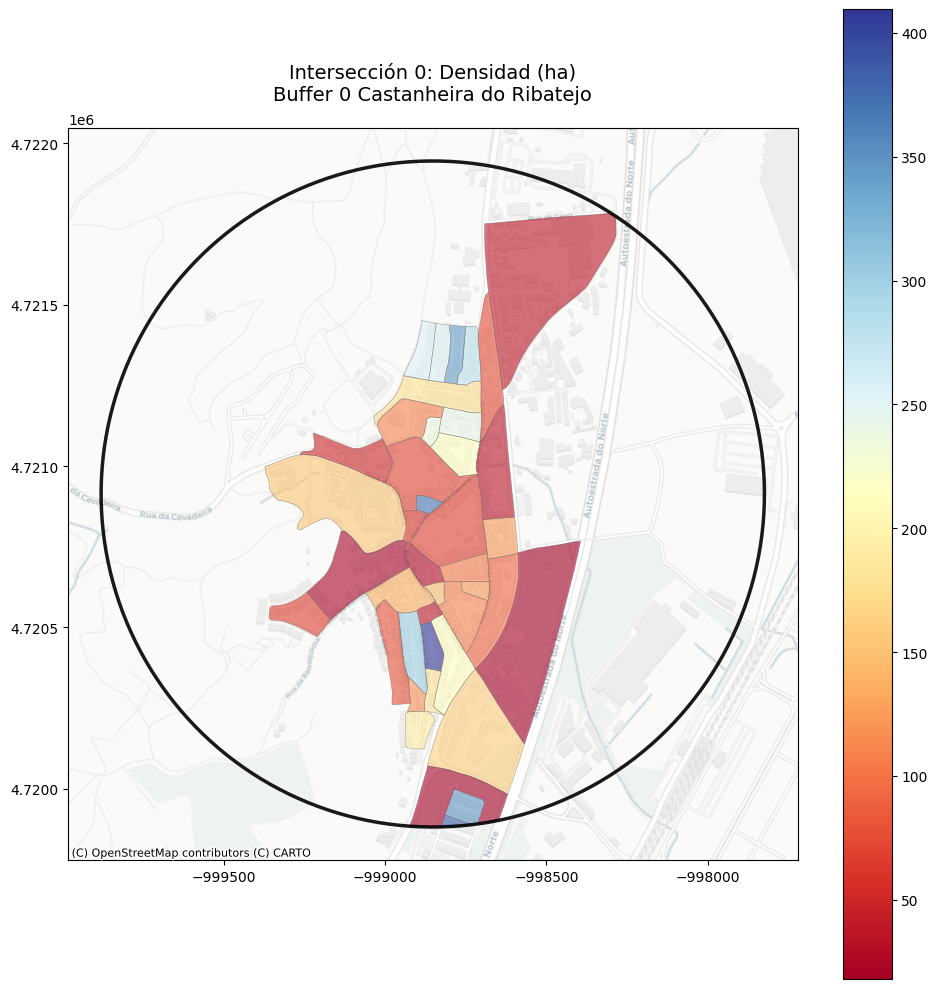

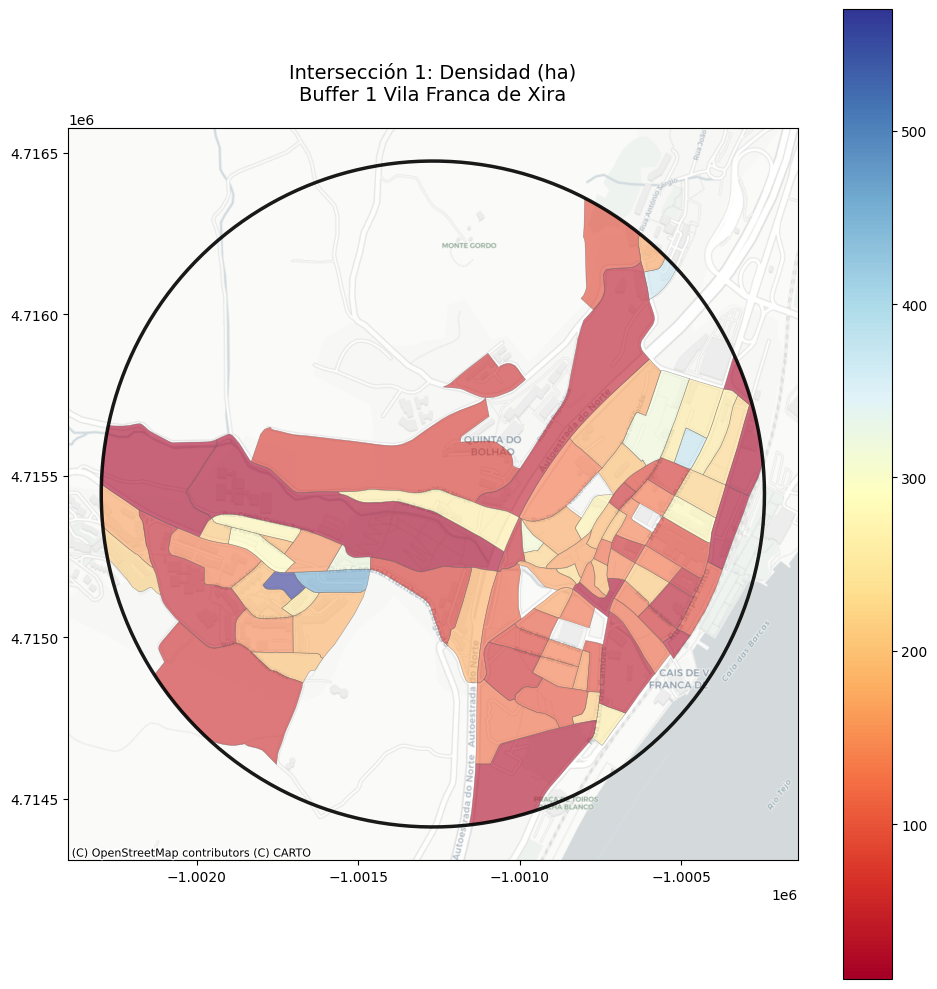

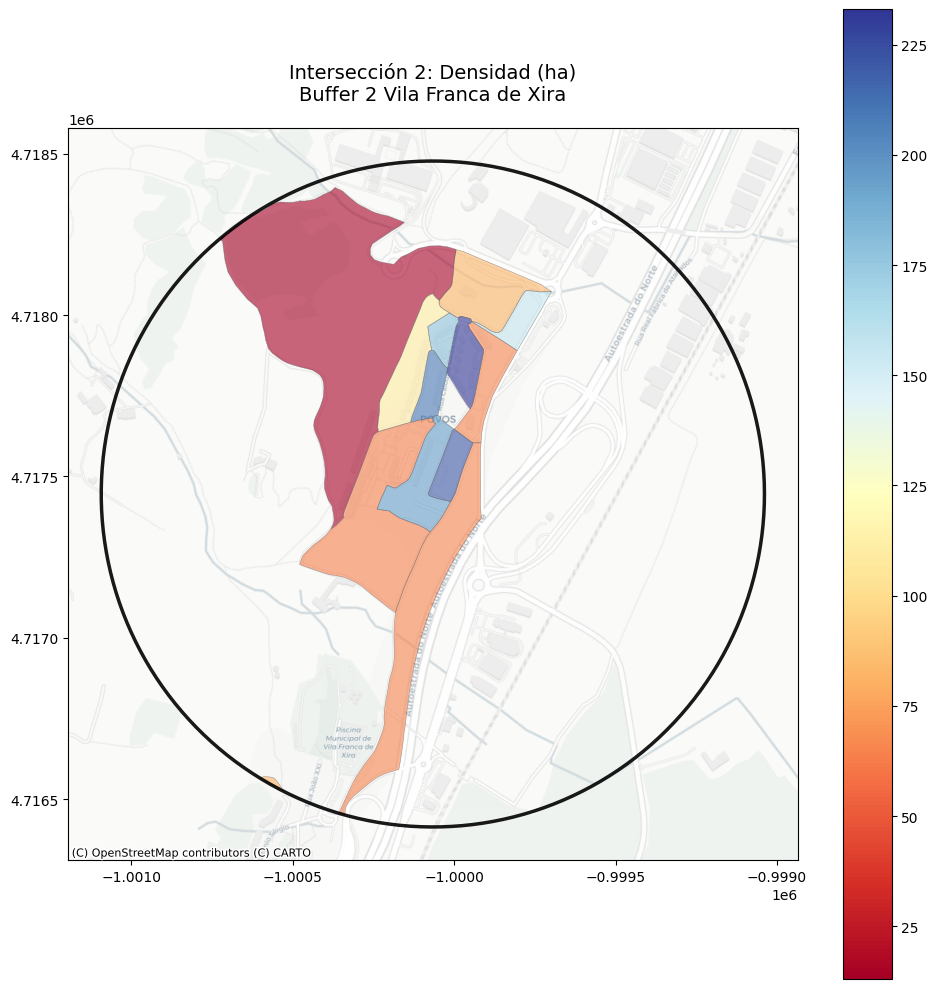

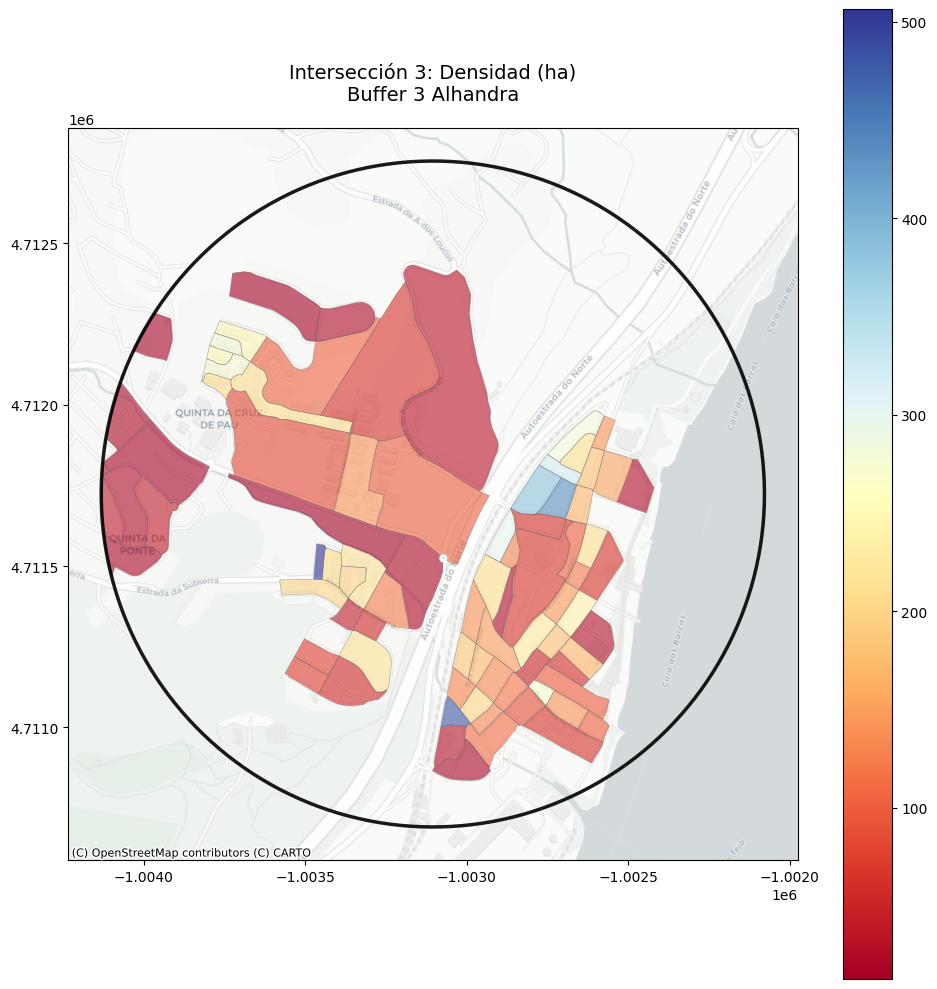

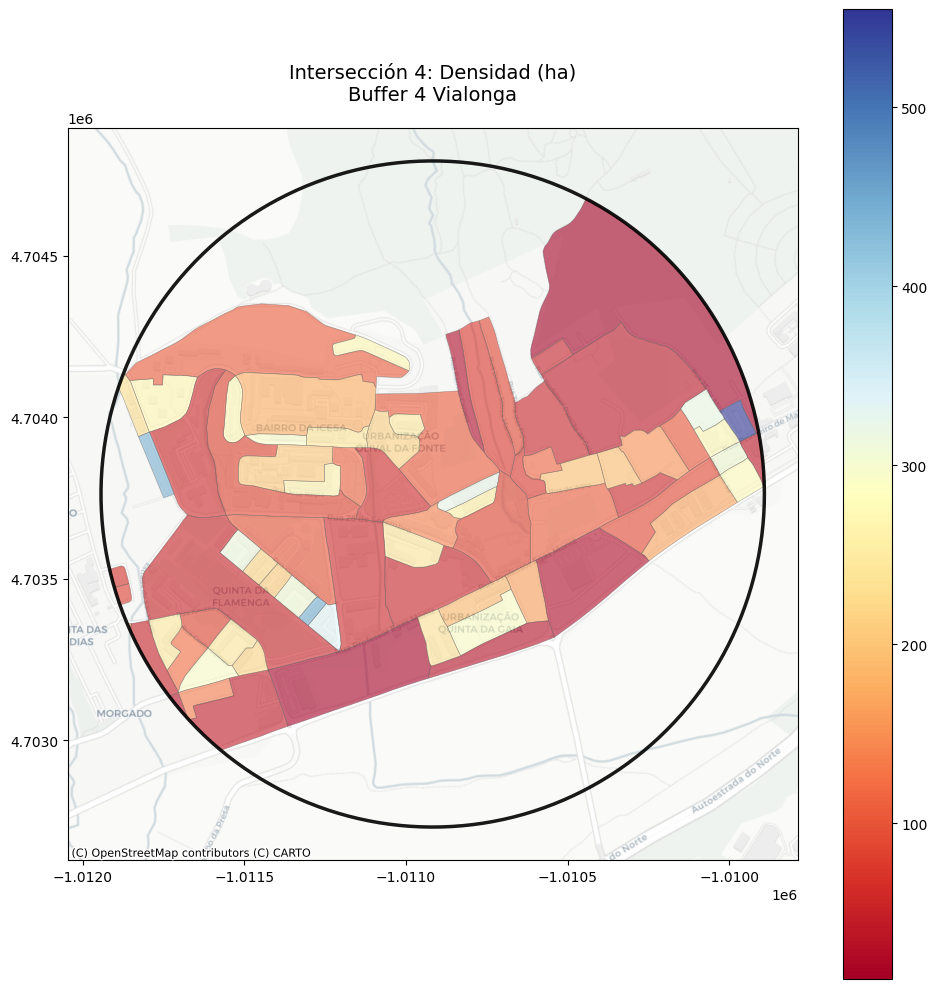

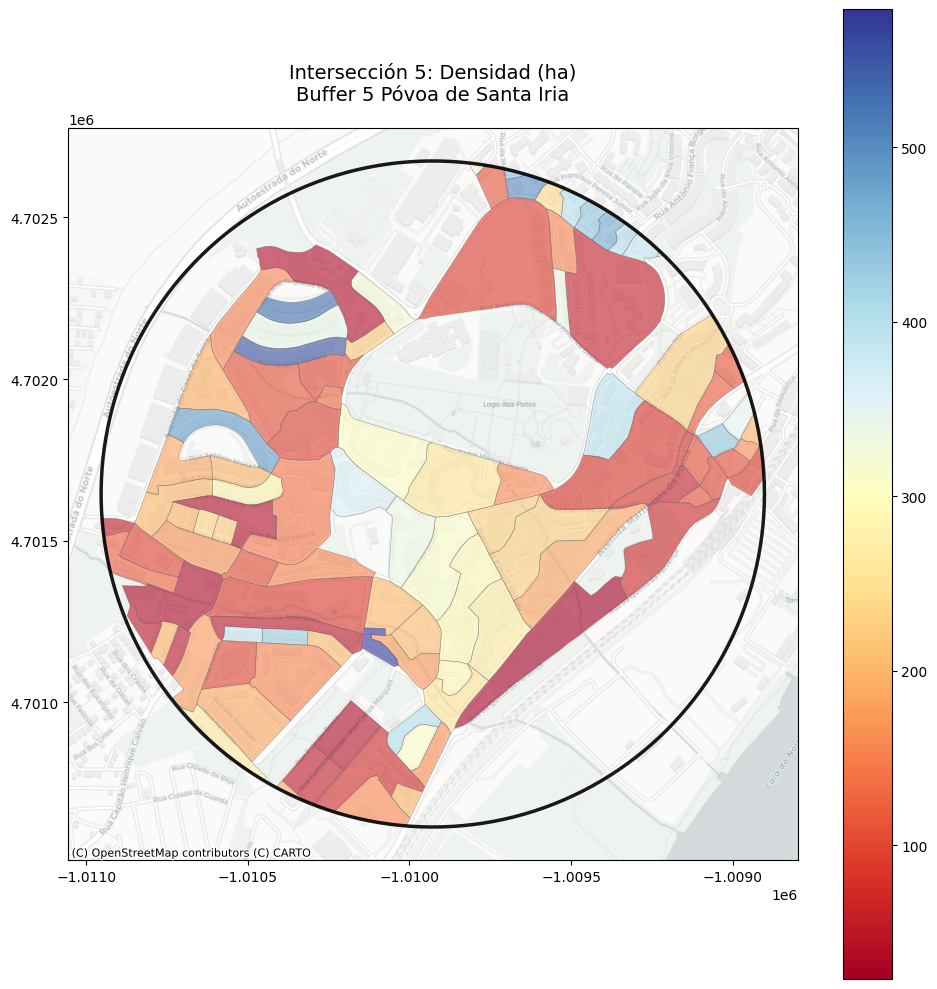

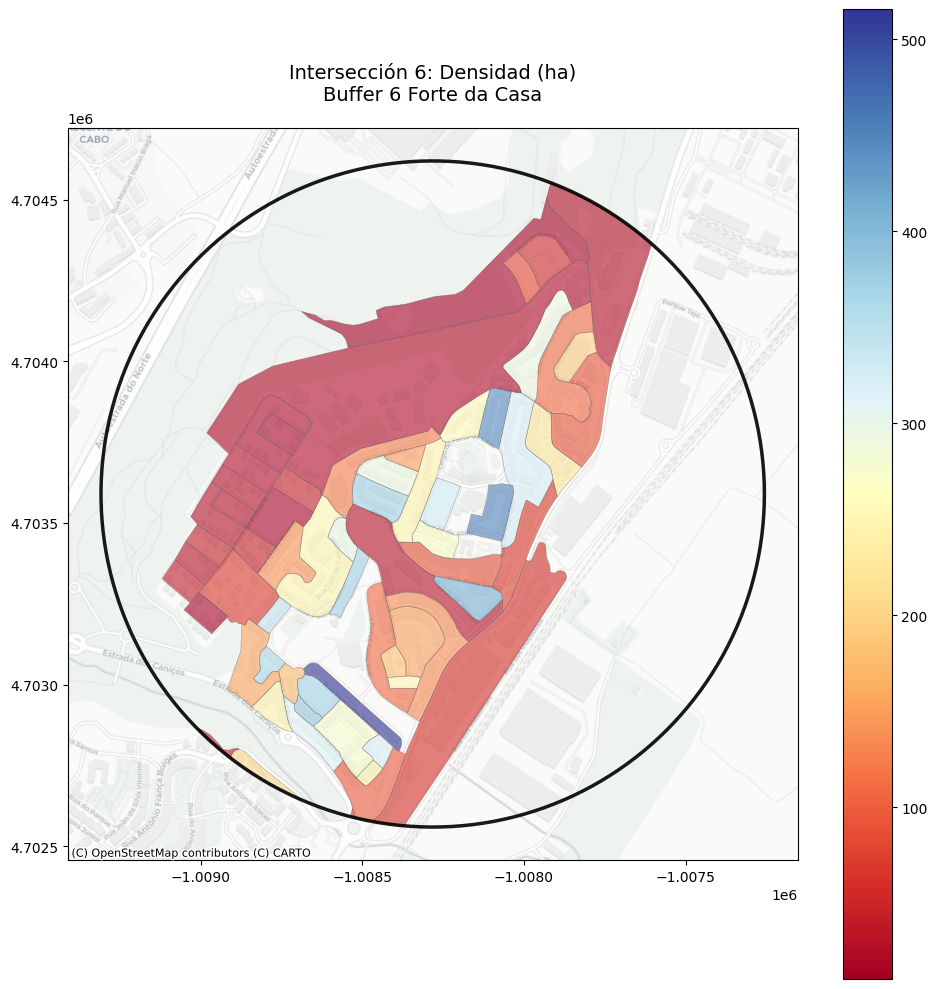

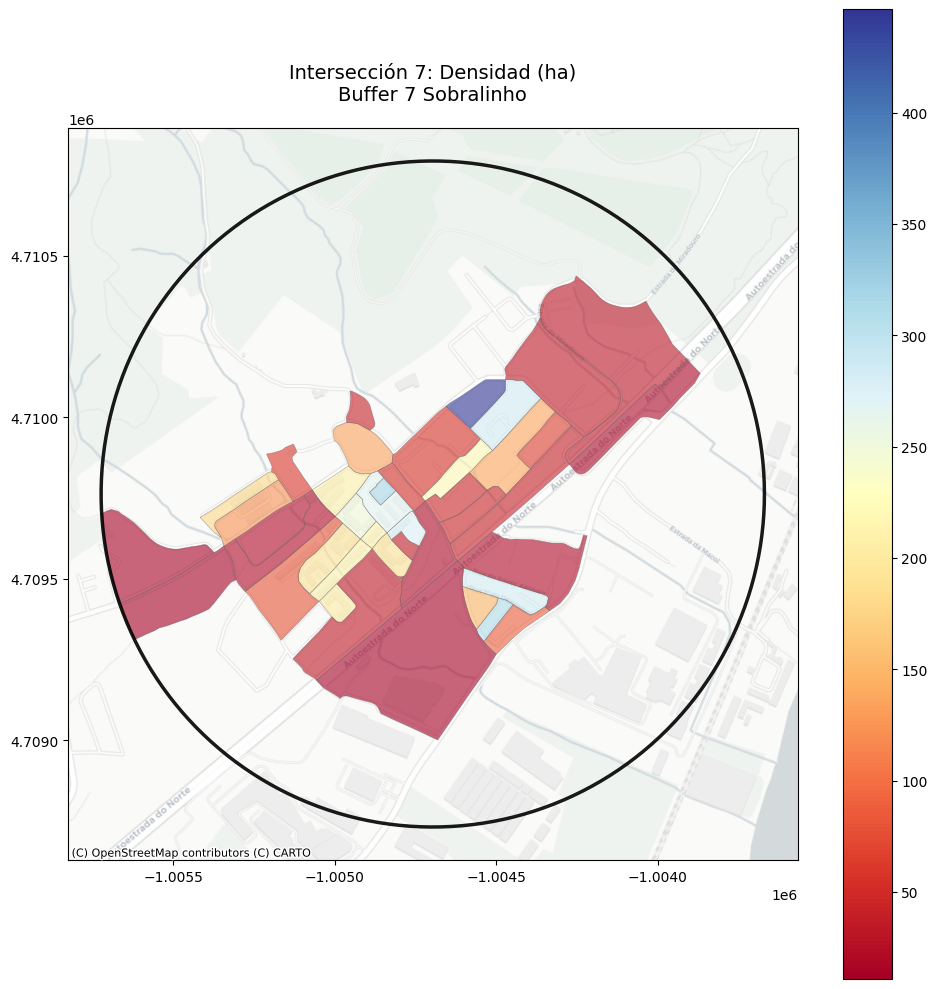

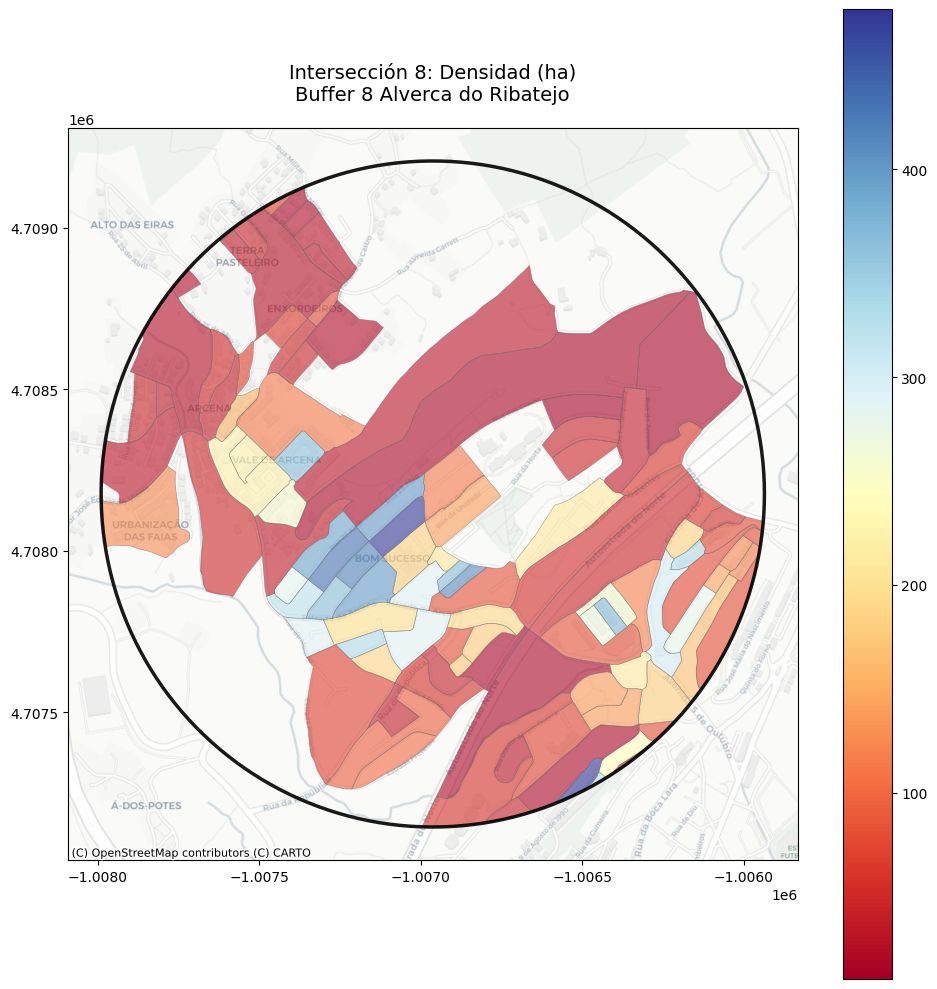

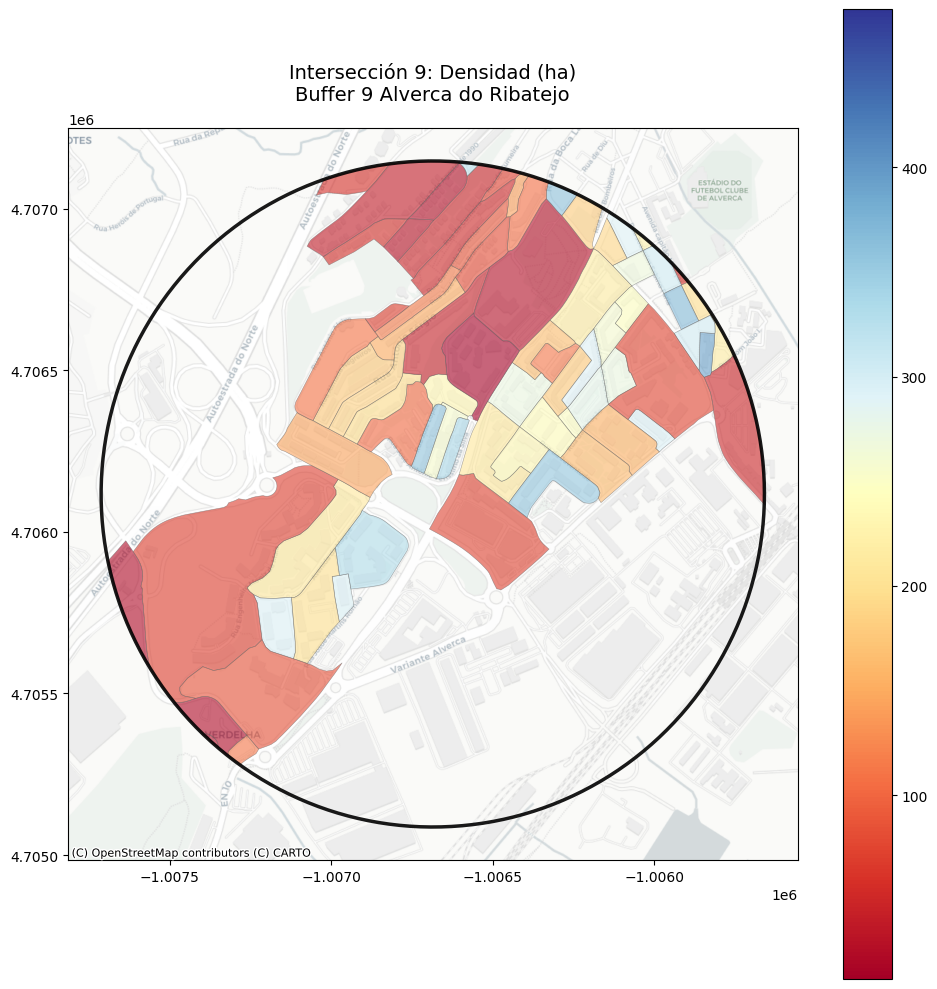

In [18]:
# Crear diccionarios para almacenar los resultados
intersections = {}  # Almacenará las intersecciones
buffers = {}       # Almacenará los buffers individuales
areas = {}         # Almacenará las áreas de las intersecciones

# Iterar a través de cada polígono buffer
for index, buffer_polygon in Bufers.iterrows():
    # Crear variable para el buffer actual (ej: buffer_0, buffer_1, ...)
    buffer_name = f"buffer_{index}"
    buffers[buffer_name] = gpd.GeoDataFrame([buffer_polygon], geometry='geometry', crs=VFX_P_filtered.crs)

    # Realizar la intersección
    intersection_name = f"intersection_{index}"
    intersections[intersection_name] = gpd.overlay(VFX_P_filtered, buffers[buffer_name], how='intersection')
    areas[intersection_name] = gpd.overlay(VFX, buffers[buffer_name], how='intersection')

    # Calcular la zona dominante por su área
    # ------------------------------------------
    # Obtener el índice del polígono con el área máxima
    dominant_index = areas[intersection_name].geometry.area.idxmax()

    # Si todas las áreas son 0, no hay zona dominante
    if areas[intersection_name].geometry.area.max() == 0:
        dominant_area_name = None
    else:
        # Si hay zonas con área, asignar el nombre de la zona dominante
        # (Asumiendo que VFX tiene una columna con nombres de zonas, ej: 'Zona')
        dominant_area_name = areas[intersection_name].loc[dominant_index, 'NAME'] if 'NAME' in areas[intersection_name].columns else None

    # Asignar el valor 'dominant_area' a la columna deseada
    areas[intersection_name]['dominant_age'] = dominant_area_name
    # ------------------------------------------

    # Si hay intersección, crear el mapa
    if not intersections[intersection_name].empty:
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))

        # Graficar
        intersections[intersection_name].plot(
            column='density_ha',
            cmap='RdYlBu',
            legend=True,
            ax=ax,
            alpha=0.6,
            linewidth=0.4,
            edgecolor='0.4'
        )

        buffers[buffer_name].plot(
            ax=ax,
            color='none',
            edgecolor='black',
            linewidth=2.5,
            alpha=0.9
        )

        ctx.add_basemap(
            ax,
            crs=VFX_P_filtered.crs.to_string(),
            source=ctx.providers.CartoDB.Positron
        )

        ax.set_title(
            f"Intersección {index}: Densidad (ha)\nBuffer {index} {dominant_area_name}",
            fontsize=14,
            pad=20
        )

        plt.tight_layout()
        plt.show()

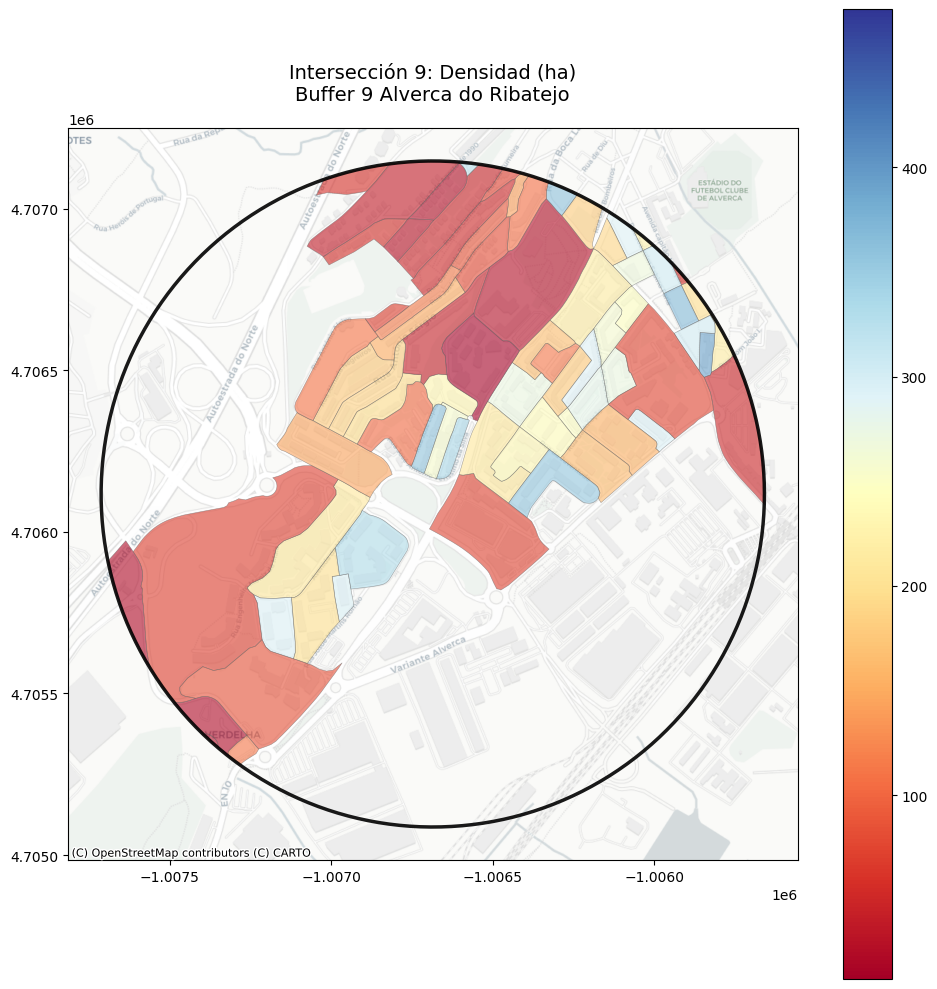

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Graficar
intersections[intersection_name].plot(
            column='density_ha',
            cmap='RdYlBu',
            legend=True,
            ax=ax,
            alpha=0.6,
            linewidth=0.4,
            edgecolor='0.4'
        )

buffers[buffer_name].plot(
            ax=ax,
            color='none',
            edgecolor='black',
            linewidth=2.5,
            alpha=0.9
        )

ctx.add_basemap(
            ax,
            crs=VFX_P_filtered.crs.to_string(),
            source=ctx.providers.CartoDB.Positron
        )

ax.set_title(
            f"Intersección {index}: Densidad (ha)\nBuffer {index} {dominant_area_name}",
            fontsize=14,
            pad=20
        )

plt.tight_layout()
plt.show()

In [19]:
# Define the function to calculate the population as a proportion of the area based on the BRGI21
def calculate_population_related(df, df_name=''):
    """Apply the calculations with column validation"""
    df=df.to_crs(epsg=3763)

    required_columns = [
        'N_INDIVIDUOS', 'N_INDIVIDUOS_H', 'N_INDIVIDUOS_M',
        'N_INDIVIDUOS_0_14', 'N_INDIVIDUOS_15_24', 'N_INDIVIDUOS_25_64', 'N_INDIVIDUOS_65_OU_MAIS',
        'geometry', 'SHAPE_Area'
    ]

    missing_cols = [col for col in required_columns if col not in df.columns]
    if missing_cols:
        print(f"Warning: {df_name} missing the columns: {missing_cols}")
        return df

    try:
        df['pob'] = (df['N_INDIVIDUOS'] * df.geometry.area) / df['SHAPE_Area']
        df['pobMen'] = (df['N_INDIVIDUOS_H'] * df.geometry.area) / df['SHAPE_Area']
        df['pobWMen'] = (df['N_INDIVIDUOS_M'] * df.geometry.area) / df['SHAPE_Area']
        df['pob_0_14'] = (df['N_INDIVIDUOS_0_14'] * df.geometry.area) / df['SHAPE_Area']
        df['pob_15_24'] = (df['N_INDIVIDUOS_15_24'] * df.geometry.area) / df['SHAPE_Area']
        df['pob_15_17'] = ((df['N_INDIVIDUOS_15_24'] * df.geometry.area) / df['SHAPE_Area']) * 0.3
        df['pob_18_24'] = ((df['N_INDIVIDUOS_15_24'] * df.geometry.area) / df['SHAPE_Area']) * 0.7
        df['pob_25_64'] = (df['N_INDIVIDUOS_25_64'] * df.geometry.area) / df['SHAPE_Area']
        df['pob_65'] = (df['N_INDIVIDUOS_65_OU_MAIS'] * df.geometry.area) / df['SHAPE_Area']
        print(f"Success: Calculations completed for {df_name}")
    except Exception as e:
        print(f"Error in {df_name}: {str(e)}")

    return df

# Process all DataFrames
for name, df in intersections.items():
    if df is not None:
        intersections[name] = calculate_population_related(df, name)
    else:
        print(f"DataFrame {name} no existe (None)")


Success: Calculations completed for intersection_0
Success: Calculations completed for intersection_1
Success: Calculations completed for intersection_2
Success: Calculations completed for intersection_3
Success: Calculations completed for intersection_4
Success: Calculations completed for intersection_5
Success: Calculations completed for intersection_6
Success: Calculations completed for intersection_7
Success: Calculations completed for intersection_8
Success: Calculations completed for intersection_9


In [20]:
# prompt: hacer que el directorio buffers tenga el mismo indice que intersections

# Create a new dictionary to store the results with matching indices
aligned_buffers = {}

# Iterate through the intersections dictionary
for i, (intersection_name, intersection_df) in enumerate(intersections.items()):
    # Access the corresponding buffer using the same index 'i'
    buffer_name = f"buffer_{i}"

    # Check if the buffer exists in the buffers dictionary
    if buffer_name in buffers:
        aligned_buffers[intersection_name] = {
            'intersection_df': intersection_df,
            'buffer_df': buffers[buffer_name]
        }
    else:
        print(f"Warning: No buffer found for intersection {intersection_name}")

# Now you have a new dictionary 'aligned_buffers' where each key (intersection name)
# has a corresponding value, which is a dictionary itself containing both
# the intersection GeoDataFrame and its corresponding buffer GeoDataFrame,
# and both share the same index.

# Example usage: access the intersection and buffer for the first intersection:
# first_intersection = aligned_buffers["intersection_0"]
# intersection_gdf = first_intersection["intersection_df"]
# buffer_gdf = first_intersection["buffer_df"]




Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_0.png


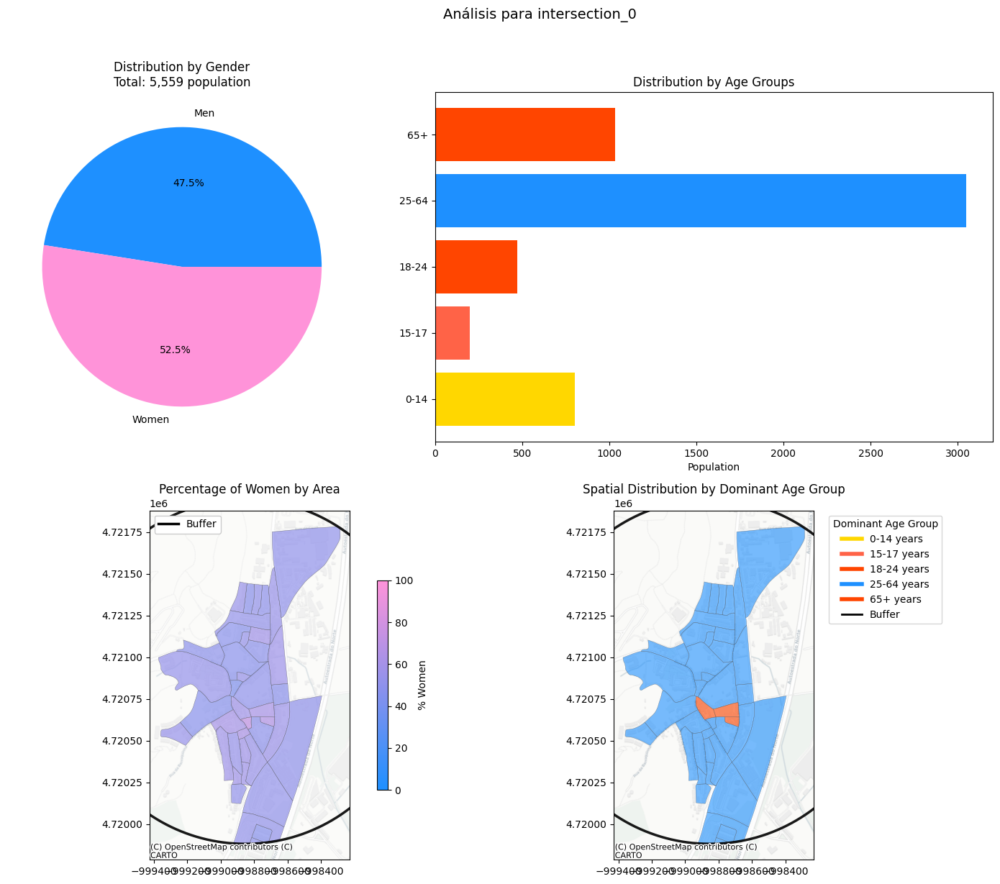

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_1.png


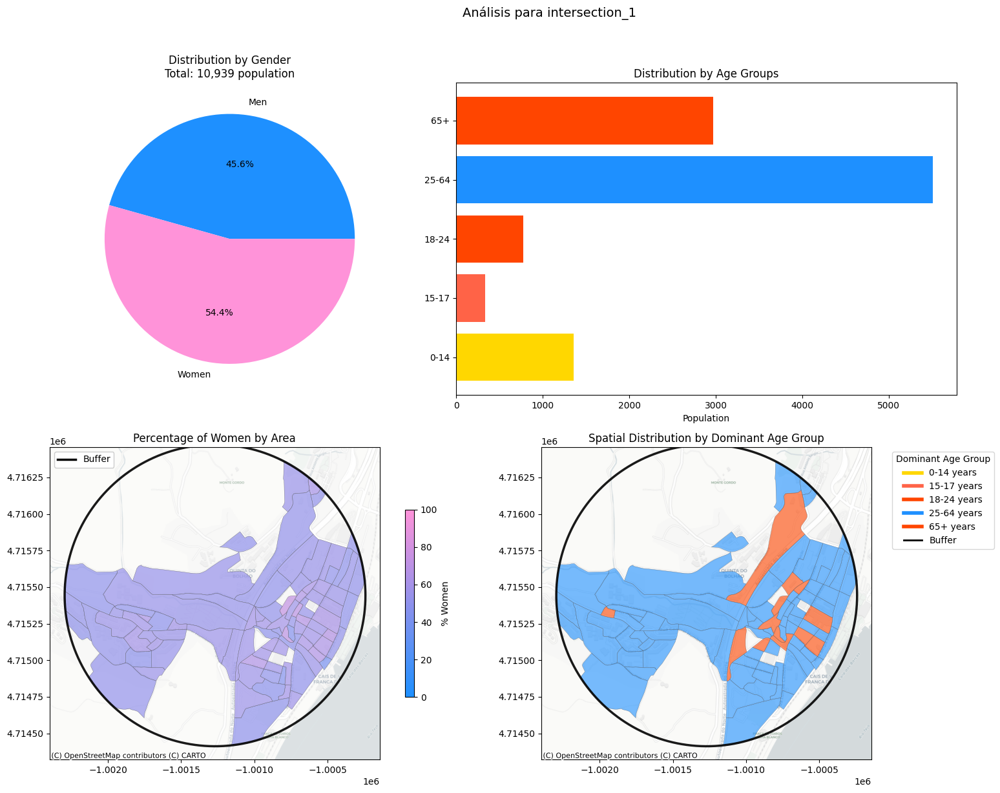

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_2.png


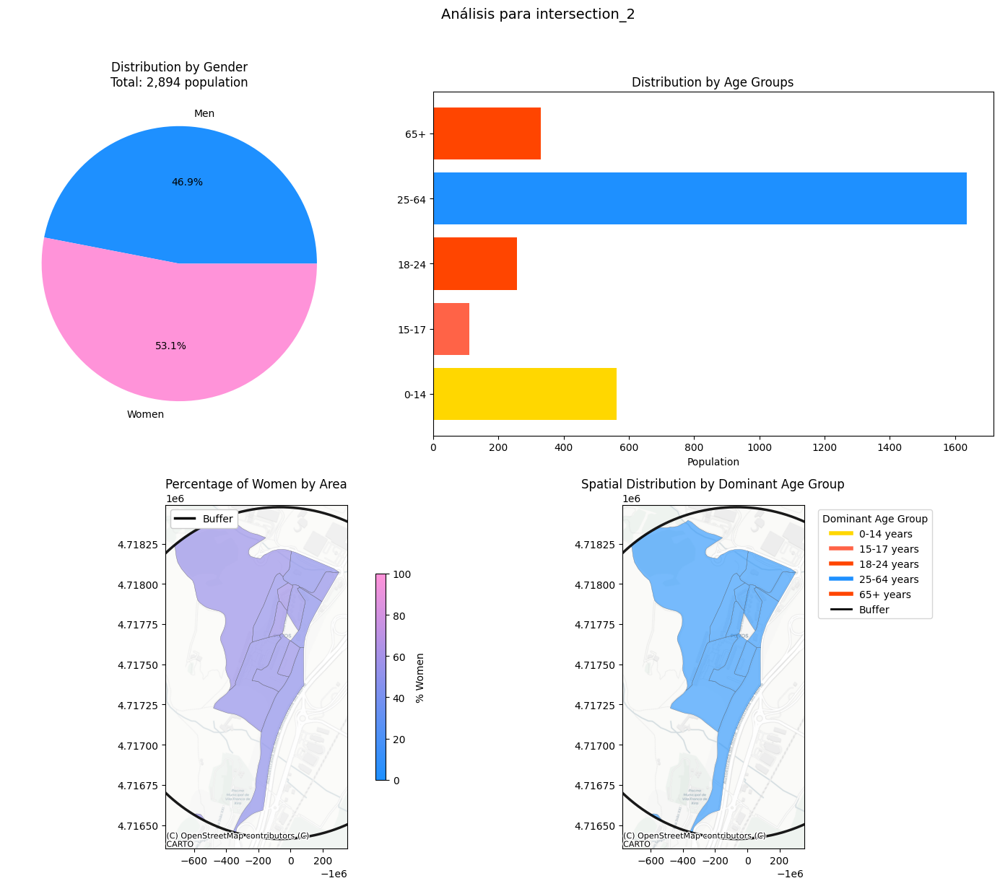

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_3.png


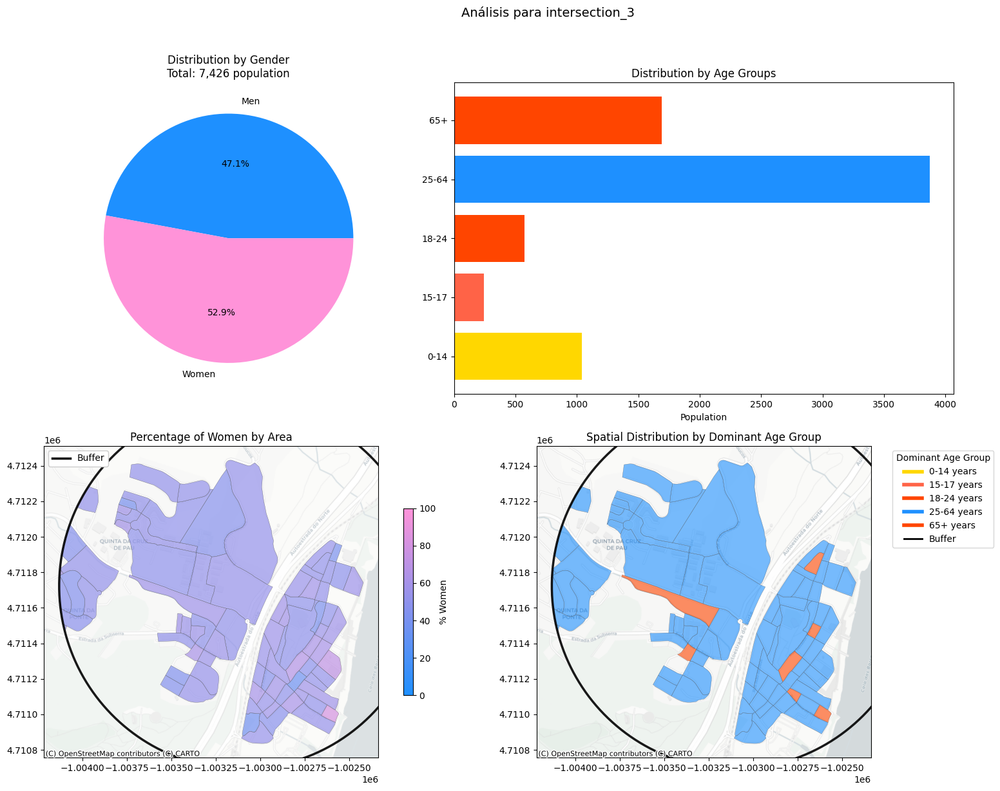

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_4.png


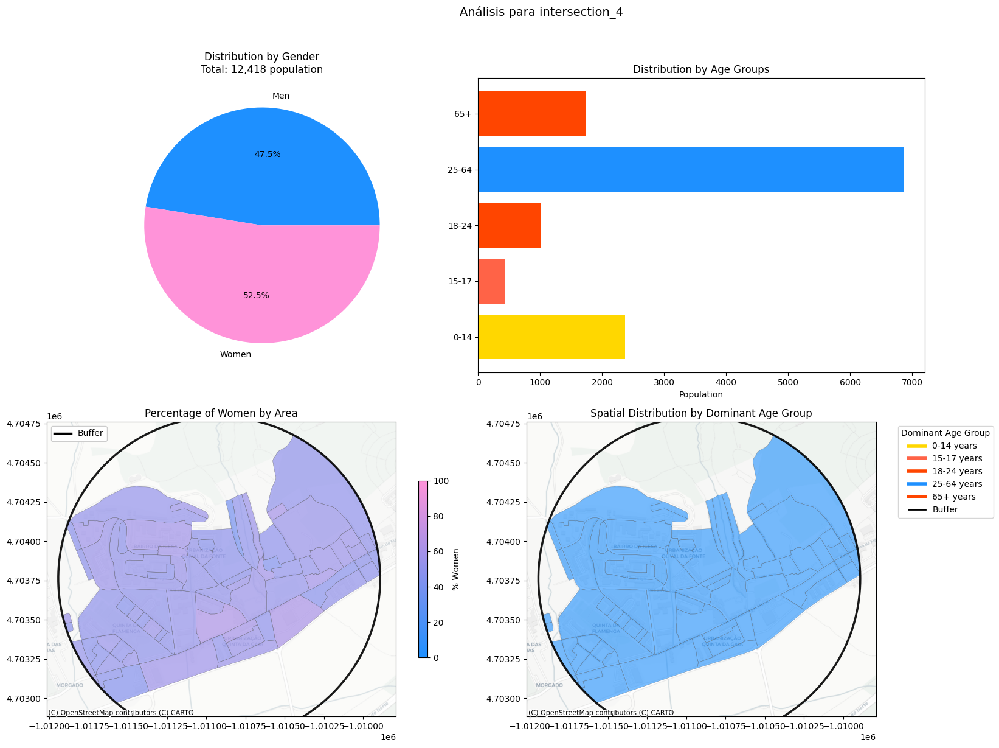

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_5.png


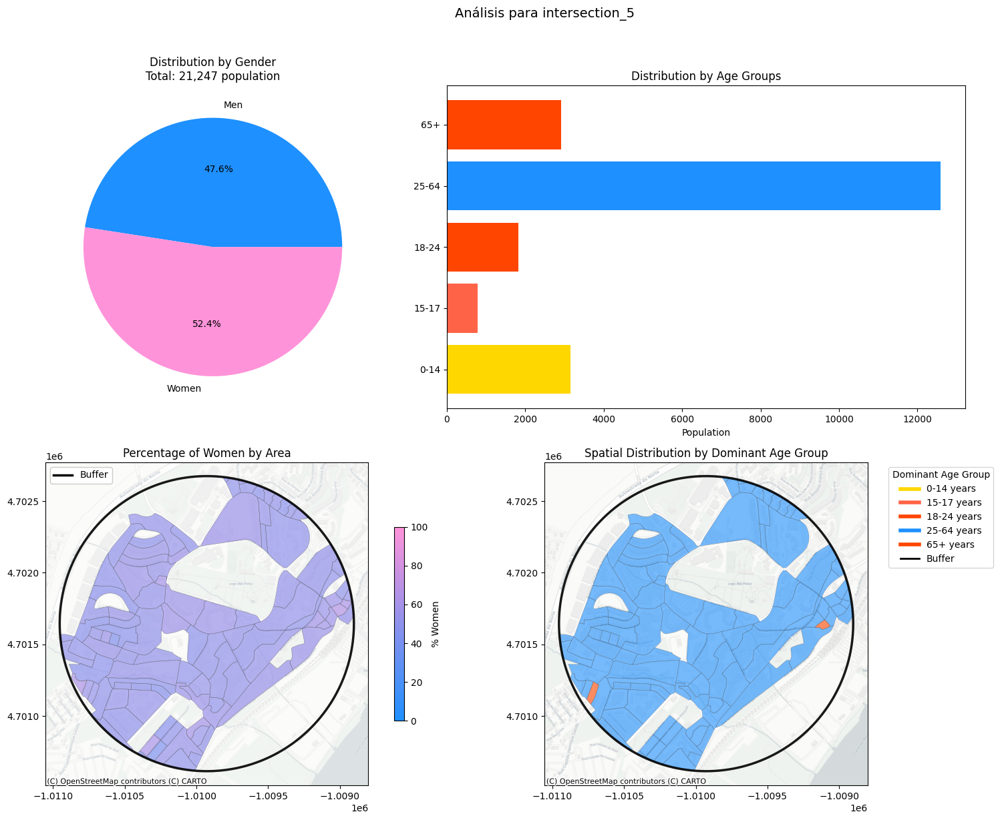

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_6.png


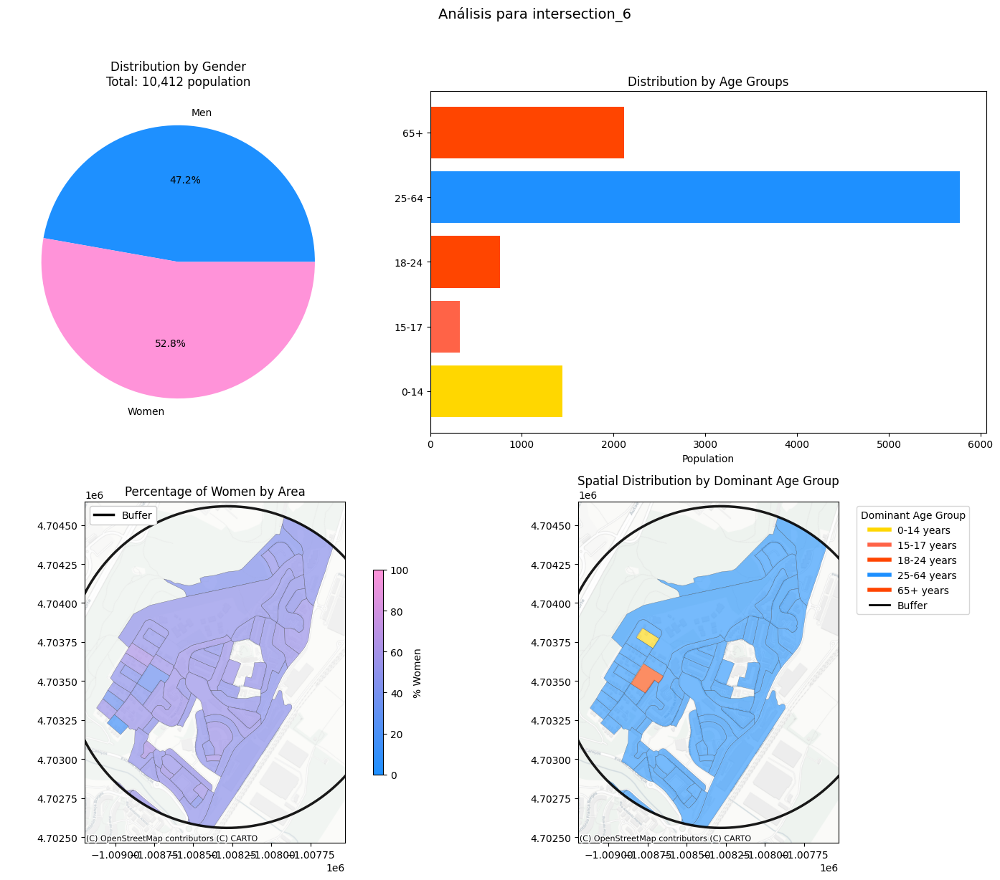

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_7.png


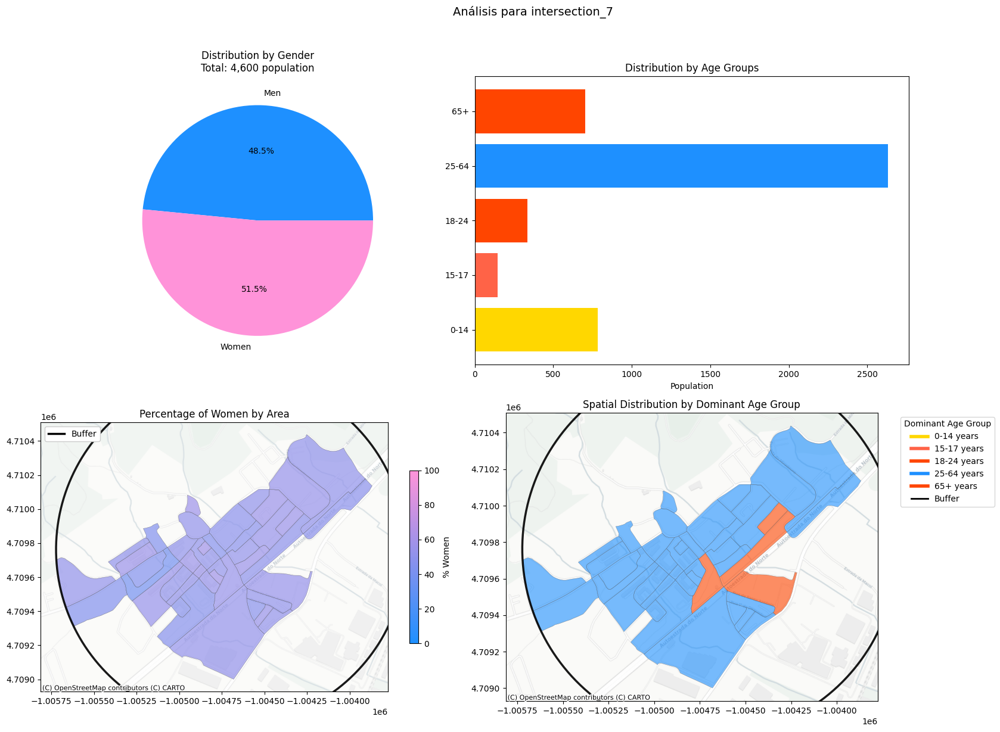

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_8.png


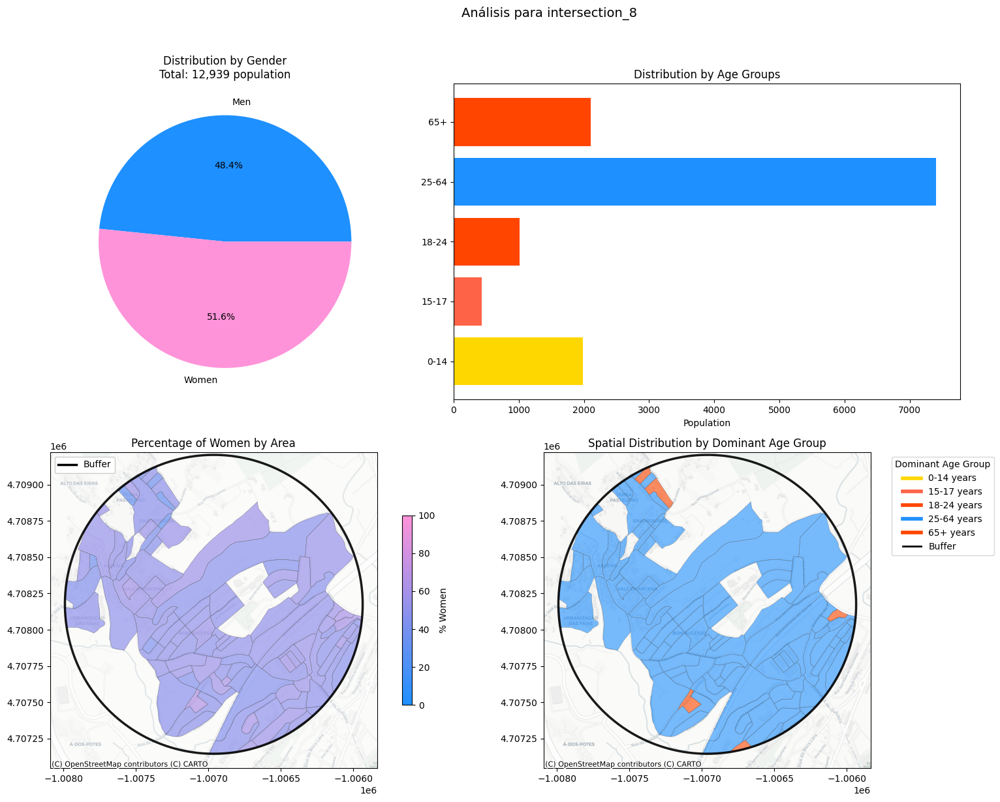

Imagen guardada en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/intersection_9.png


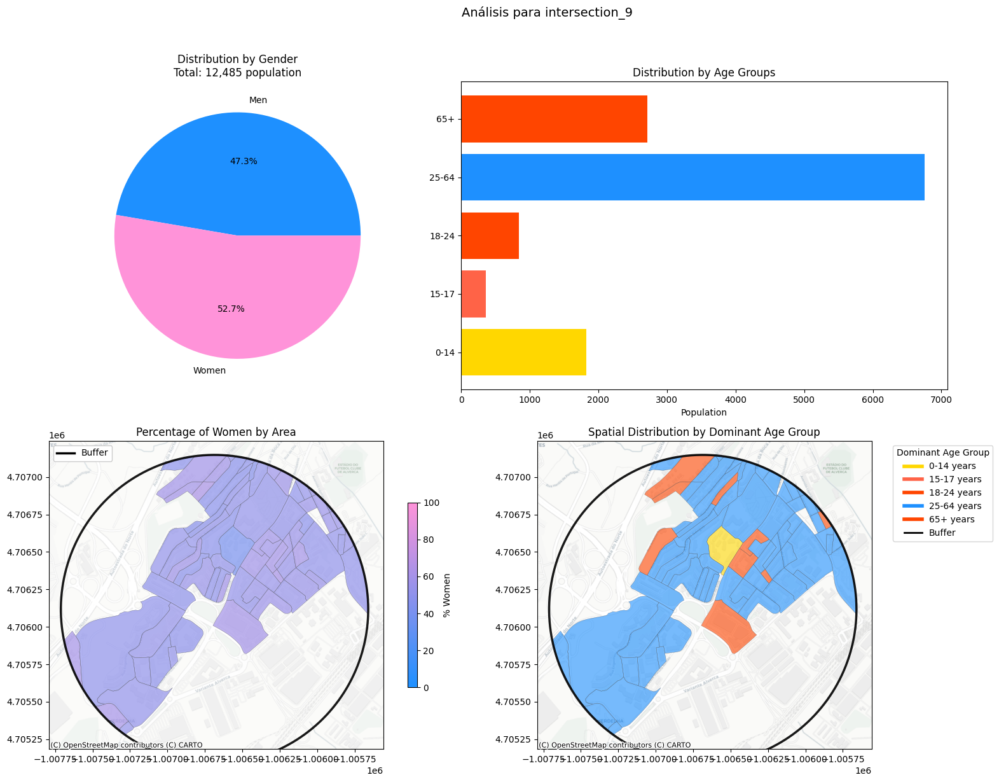

In [21]:
def plot_combinado(gdf, buffer, title, save_path=None):
    gdf=gdf.to_crs(epsg=3857)

    """Compact version with fully coordinated color schemes"""
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(18, 12))

    # Definir paletas de colores coordinadas
    COLORS = {
        'male': '#1E90FF',  # Azul
        'female': '#ff93d9'  # Rosa claro
    }

    age_palette = {
        '0-14': '#FFD700',  # Amarillo dorado
        '15-17': '#FF6347',  # Naranja oscuro
        '18-24': '#FF4500',  # Rojo naranja
        '25-64': '#1E90FF',  # Azul dodger
        '65+': '#FF4500'     # Rojo naranja
    }

    # ===== ax1: Gráfico de género (torta) =====
    hombres = gdf['pobMen'].sum()
    mujeres = gdf['pobWMen'].sum()
    total = hombres + mujeres
    ax1.pie([hombres, mujeres], labels=['Men', 'Women'],
            autopct='%1.1f%%', colors=[COLORS['male'], COLORS['female']])
    ax1.set_title(f'Distribution by Gender\nTotal: {total:,.0f} population')

    # ===== ax2: Pirámide poblacional =====
    edades = {
        '0-14': gdf['pob_0_14'].sum(),
        '15-17': gdf['pob_15_17'].sum(),
        '18-24': gdf['pob_18_24'].sum(),
        '25-64': gdf['pob_25_64'].sum(),
        '65+': gdf['pob_65'].sum()
    }
    for age_group, value in edades.items():
        ax2.barh(age_group, value, color=age_palette[age_group])
    ax2.set_title('Distribution by Age Groups')
    ax2.set_xlabel('Population')

    # ===== ax3: Mapa de % mujeres (escala personalizada) =====
    gdf['%_mujeres'] = (gdf['pobWMen'] / (gdf['pobMen'] + gdf['pobWMen'])) * 100

    # Crear mapa de colores personalizado de male a female
    from matplotlib.colors import LinearSegmentedColormap
    gender_cmap = LinearSegmentedColormap.from_list(
        'gender_cmap', [COLORS['male'], COLORS['female']])

    gdf.plot(column='%_mujeres', cmap=gender_cmap,
             legend=True, ax=ax3,
             alpha=0.7,  # Mayor transparencia para ver el mapa base
             linewidth=0.3,
             edgecolor='0.3',
             legend_kwds={
                 'label': "% Women",
                 'shrink': 0.6,
                 'orientation': 'vertical'
             },
             vmin=0, vmax=100)  # Fijar rango 0-100%

    ctx.add_basemap(ax3, crs=gdf.crs.to_string(),
                   source=ctx.providers.CartoDB.Positron,
                   alpha=0.8)
    ax3.set_title('Percentage of Women by Area')

    # Área de intervención
    # Por:
    if buffer is not None:
        buffer.plot(ax=ax3,
                           color='none',
                           edgecolor='black',
                           linewidth=2.5,
                           alpha=0.9)

    # Unified legend
    legend_elements = []
    if buffer is not None:
        legend_elements.append(
            Line2D([0], [0], color='black', lw=2.5,
                  label='Buffer'))

    if legend_elements:
        ax3.legend(handles=legend_elements,
                 loc='upper left',
                 framealpha=1)

    # ===== ax4: Mapa de edad dominante =====
    age_cols = ['pob_0_14', 'pob_15_17', 'pob_18_24', 'pob_25_64', 'pob_65']
    age_mapping = {
        'pob_0_14': '0-14',
        'pob_15_17': '15-17',
        'pob_18_24': '18-24',
        'pob_25_64': '25-64',
        'pob_65': '65+'
    }

    # Calcular edad dominante con validación de ceros
    def get_dominant_age(row):
        max_val = max(row[age_cols])
        if max_val == 0:
            return None  # No hay grupo dominante si todos son cero
        return row[age_cols].idxmax()

    gdf['dominant_age'] = gdf.apply(get_dominant_age, axis=1)

    # Solo graficar si hay grupos dominantes válidos
    valid_age_groups = gdf[gdf['dominant_age'].notnull()]

    if not valid_age_groups.empty:
        for age_col in age_cols:
            subset = valid_age_groups[valid_age_groups['dominant_age'] == age_col]
            if not subset.empty:
                subset.plot(ax=ax4,
                           color=age_palette[age_mapping[age_col]],
                           alpha=0.6,
                           linewidth=0.3,
                           edgecolor='0.3',
                           label=age_mapping[age_col])
    else:
        # Mostrar mensaje si no hay datos válidos
        ax4.text(0.5, 0.5, 'No dominant age groups\n(all values zero)',
                ha='center', va='center', transform=ax4.transAxes,
                fontsize=12, color='gray')

    ctx.add_basemap(ax4, crs=gdf.crs.to_string(),
                   source=ctx.providers.CartoDB.Positron)

    # Por:
    if buffer is not None:
        buffer.plot(ax=ax4,
                                 color='none',
                                 edgecolor='black',
                                 linewidth=2.5,
                                 alpha=0.9)

   # Leyenda unificada
    legend_elements = [
        Line2D([0], [0], color=age_palette['0-14'], lw=4, label='0-14 years'),
        Line2D([0], [0], color=age_palette['15-17'], lw=4, label='15-17 years'),
        Line2D([0], [0], color=age_palette['18-24'], lw=4, label='18-24 years'),
        Line2D([0], [0], color=age_palette['25-64'], lw=4, label='25-64 years'),
        Line2D([0], [0], color=age_palette['65+'], lw=4, label='65+ years'),
        Line2D([0], [0], color='black', lw=2, label='Buffer')
    ]

    ax4.legend(handles=legend_elements,
              title='Dominant Age Group',
              bbox_to_anchor=(1.05, 1),
              loc='upper left')

    ax4.set_title('Spatial Distribution by Dominant Age Group')

    # Ajustes finales
    plt.suptitle(title, y=1.02, fontsize=14)
    plt.tight_layout()
    plt.subplots_adjust(right=0.85)  # Espacio para leyenda

    # Guardar la imagen si se especificó una ruta
    if save_path:
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.savefig(save_path.replace('.png', '.pdf'), format='pdf', bbox_inches='tight')
        plt.savefig(save_path.replace('.png', '.svg'), format='svg', bbox_inches='tight')
        print(f"Imagen guardada en: {save_path}")

    plt.show()
    plt.close()  # Cerrar la figura para liberar memoria

# Ruta base donde guardar las imágenes (modifica esto)
BASE_SAVE_PATH = "/content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/"  # Usa / en lugar de \ en Windows

# Apply compact version
for intersection_name, data_dict in aligned_buffers.items():
    # Extraer los DataFrames
    current_gdf = data_dict['intersection_df']
    current_buffer = data_dict['buffer_df']

    # Generar nombre de archivo
    filename = f"{intersection_name}.png".replace(" ", "_").replace("/", "-")
    full_path = os.path.join(BASE_SAVE_PATH, filename)

    # Llamar a la función de plotting
    plot_combinado(
        gdf=current_gdf,
        buffer=current_buffer,
        title=f"Análisis para {intersection_name}",
        save_path=full_path
    )

In [ ]:
def calcular_distribucion_edad_genero(gdf):
    """
    Calcula la distribución combinada de edad y género usando las columnas reales disponibles.
    """
    resultados = {}

    # 1. Población total por género (usando las columnas correctas)
    total_hombres = gdf['pobMen'].sum()
    total_mujeres = gdf['pobWMen'].sum()
    total_poblacion = gdf['pob'].sum()

    # 2. Calcular ratios de género (para distribución proporcional)
    if total_poblacion > 0:
        ratio_h = total_hombres / total_poblacion
        ratio_m = total_mujeres / total_poblacion
    else:
        ratio_h = ratio_m = 0.5

    # 3. Grupos de edad disponibles
    grupos_edad = {
        '0-14': 'pob_0_14',
        '15-17': 'pob_15_17',
        '18-24': 'pob_18_24',
        '25-64': 'pob_25_64',
        '65+': 'pob_65'
    }

    # 4. Calcular distribución para cada grupo
    for grupo, col_edad in grupos_edad.items():
        if col_edad in gdf.columns:
            total_edad = gdf[col_edad].sum()
            resultados[f'{grupo}_Total'] = total_edad
            resultados[f'{grupo}_H'] = total_edad * ratio_h
            resultados[f'{grupo}_M'] = total_edad * ratio_m
        else:
            resultados[f'{grupo}_Total'] = 0
            resultados[f'{grupo}_H'] = 0
            resultados[f'{grupo}_M'] = 0

    return resultados

def generar_reporte_final(aligned_buffers, BASE_SAVE_PATH):
    # Crear el archivo Excel
    wb = Workbook()
    ws_summary = wb.active
    ws_summary.title = "Resumen Edad-Género"

    # Encabezados del reporte
    headers = [
        "Buffer ID", "Población Total", "Hombres", "Mujeres", "% Mujeres",
        "0-14 Total", "0-14 Hombres", "0-14 Mujeres",
        "15-17 Total", "15-17 Hombres", "15-17 Mujeres",
        "18-24 Total", "18-24 Hombres", "18-24 Mujeres",
        "25-64 Total", "25-64 Hombres", "25-64 Mujeres",
        "65+ Total", "65+ Hombres", "65+ Mujeres",
        "Grupo Dominante", "Área (ha)", "Densidad (hab/ha)"
    ]
    ws_summary.append(headers)

    # Procesar todos los buffers
    for name, data in aligned_buffers.items():
        gdf = data['intersection_df']

        # Calcular distribución
        distribucion = calcular_distribucion_edad_genero(gdf)

        # Métricas básicas
        total_pob = gdf['N_INDIVIDUOS'].sum()
        hombres = gdf['N_INDIVIDUOS_H'].sum()
        mujeres = gdf['N_INDIVIDUOS_M'].sum()
        pct_mujeres = (mujeres / total_pob * 100) if total_pob > 0 else 0

        # Determinar grupo dominante
        grupos_edad = ['0-14', '15-17', '18-24', '25-64', '65+']
        grupos_conteo = {f'{g}_Total': distribucion[f'{g}_Total'] for g in grupos_edad}
        grupo_dominante = max(grupos_conteo.items(), key=lambda x: x[1])[0].replace('_Total', '') if any(grupos_conteo.values()) else "N/A"

        # Calcular área y densidad
        area = gdf.geometry.area.sum() / 10000  # en hectáreas
        densidad = total_pob / area if area > 0 else 0

        # Construir fila de datos
        row_data = [
            name, total_pob, hombres, mujeres, pct_mujeres,
            distribucion['0-14_Total'], distribucion['0-14_H'], distribucion['0-14_M'],
            distribucion['15-17_Total'], distribucion['15-17_H'], distribucion['15-17_M'],
            distribucion['18-24_Total'], distribucion['18-24_H'], distribucion['18-24_M'],
            distribucion['25-64_Total'], distribucion['25-64_H'], distribucion['25-64_M'],
            distribucion['65+_Total'], distribucion['65+_H'], distribucion['65+_M'],
            grupo_dominante, area, densidad
        ]
        ws_summary.append(row_data)

    # Ajustar formato (CORRECCIÓN DEL ERROR DE SINTAXIS AQUÍ)
    for column in ws_summary.columns:
        max_length = max(len(str(cell.value)) for cell in column)  # Paréntesis corregidos
        adjusted_width = min(max_length + 2, 30)
        ws_summary.column_dimensions[column[0].column_letter].width = adjusted_width

    # Guardar el reporte
    excel_path = os.path.join(BASE_SAVE_PATH, "reporte_edad_genero_final.xlsx")
    wb.save(excel_path)
    print(f"Reporte final guardado en: {excel_path}")

    return excel_path

# Generar el reporte final
reporte_final = generar_reporte_final(aligned_buffers, BASE_SAVE_PATH)

Reporte final guardado en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/reporte_edad_genero_final.xlsx


In [ ]:
import pandas as pd
from openpyxl import Workbook
from openpyxl.utils.dataframe import dataframe_to_rows
import matplotlib.pyplot as plt
import os

def calcular_distribucion_edad_genero(gdf):
    """
    Función mejorada para calcular distribución por edad y género
    que se adapta a las columnas realmente disponibles
    """
    resultados = {}

    # 1. Calcular ratios de género (usando las columnas correctas)
    total_hombres = gdf['pobMen'].sum()
    total_mujeres = gdf['pobWMen'].sum()
    total_poblacion = gdf['pob'].sum()

    if total_poblacion > 0:
        ratio_h = total_hombres / total_poblacion
        ratio_m = total_mujeres / total_poblacion
    else:
        ratio_h = ratio_m = 0.5

    # 2. Grupos de edad disponibles
    grupos_edad = {
        '0-14': 'pob_0_14',
        '15-17': 'pob_15_17',
        '18-24': 'pob_18_24',
        '25-64': 'pob_25_64',
        '65+': 'pob_65'
    }

    # 3. Calcular distribución para cada grupo
    for grupo, col_edad in grupos_edad.items():
        if col_edad in gdf.columns:
            total_edad = gdf[col_edad].sum()
            resultados[f'{grupo}_H'] = total_edad * ratio_h
            resultados[f'{grupo}_M'] = total_edad * ratio_m
        else:
            resultados[f'{grupo}_H'] = 0
            resultados[f'{grupo}_M'] = 0

    return resultados

def generar_reporte_completo_mejorado(aligned_buffers, BASE_SAVE_PATH):
    """Versión mejorada del reporte completo"""
    # Crear el archivo Excel
    wb = Workbook()
    ws_summary = wb.active
    ws_summary.title = "Resumen Completo"

    # Crear hojas adicionales
    ws_detalle = wb.create_sheet("Detalle por Edad-Género")
    ws_estadisticas = wb.create_sheet("Estadísticas")

    # Encabezados mejorados
    headers = [
        "Buffer ID", "Población Total", "Hombres", "Mujeres", "% Mujeres",
        "0-14 Hombres", "0-14 Mujeres", "15-17 Hombres", "15-17 Mujeres",
        "18-24 Hombres", "18-24 Mujeres", "25-64 Hombres", "25-64 Mujeres",
        "65+ Hombres", "65+ Mujeres", "Grupo Dominante",
        "Área (ha)", "Densidad (hab/ha)", "Ruta Imagen"
    ]
    ws_summary.append(headers)

    # Procesar todos los buffers
    all_data = []
    detalle_headers_added = False

    for name, data in aligned_buffers.items():
        gdf = data['intersection_df']

        # Calcular métricas básicas (usando columnas reales)
        total_pob = gdf['pob'].sum()
        hombres = gdf['pobMen'].sum()
        mujeres = gdf['pobWMen'].sum()
        pct_mujeres = (mujeres / total_pob * 100) if total_pob > 0 else 0

        # Calcular distribución edad-género
        distribucion = calcular_distribucion_edad_genero(gdf)

        # Determinar grupo dominante
        grupos_edad = ['0-14', '15-17', '18-24', '25-64', '65+']
        grupos_conteo = {f'{g}_H': distribucion[f'{g}_H'] + distribucion[f'{g}_M'] for g in grupos_edad}
        grupo_dominante = max(grupos_conteo.items(), key=lambda x: x[1])[0].replace('_H', '') if any(grupos_conteo.values()) else "N/A"

        # Calcular área y densidad
        area = gdf.geometry.area.sum() / 10000  # en hectáreas
        densidad = total_pob / area if area > 0 else 0

        # Ruta de la imagen
        img_path = os.path.join(BASE_SAVE_PATH, f"{name}.png")

        # Construir fila de datos
        row_data = [
            name, total_pob, hombres, mujeres, pct_mujeres,
            distribucion['0-14_H'], distribucion['0-14_M'],
            distribucion['15-17_H'], distribucion['15-17_M'],
            distribucion['18-24_H'], distribucion['18-24_M'],
            distribucion['25-64_H'], distribucion['25-64_M'],
            distribucion['65+_H'], distribucion['65+_M'],
            grupo_dominante, area, densidad, img_path
        ]
        ws_summary.append(row_data)
        all_data.append(row_data)

        # Hoja de detalle
        if not detalle_headers_added:
            detalle_headers = ["Buffer ID"] + list(distribucion.keys()) + ["Total"]
            ws_detalle.append(detalle_headers)
            detalle_headers_added = True

        detalle_row = [name] + list(distribucion.values()) + [total_pob]
        ws_detalle.append(detalle_row)

    # Hoja de estadísticas
    df_summary = pd.DataFrame(all_data, columns=headers)
    stats = df_summary.describe()

    for r in dataframe_to_rows(stats, index=True, header=True):
        ws_estadisticas.append(r)

    # Ajustar formato
    for sheet in wb.worksheets:
        for column in sheet.columns:
            max_length = max(len(str(cell.value)) for cell in column)
            adjusted_width = min(max_length + 2, 30)
            sheet.column_dimensions[column[0].column_letter].width = adjusted_width

    # Guardar el archivo
    excel_path = os.path.join(BASE_SAVE_PATH, "reporte_completo_mejorado.xlsx")
    wb.save(excel_path)
    print(f"Reporte completo mejorado guardado en: {excel_path}")

    # Generar gráfico adicional
    generar_grafico_piramide(df_summary, BASE_SAVE_PATH)

    return excel_path

def generar_grafico_piramide(df, save_path):
    """Genera pirámide poblacional con los datos del reporte"""
    grupos = ['0-14', '15-17', '18-24', '25-64', '65+']
    hombres = [df[f'{g} Hombres'].sum() for g in grupos]
    mujeres = [df[f'{g} Mujeres'].sum() for g in grupos]

    fig, ax = plt.subplots(figsize=(10, 6))
    y_pos = range(len(grupos))

    ax.barh(y_pos, hombres, color='#1E90FF', label='Hombres')
    ax.barh(y_pos, [-m for m in mujeres], color='#FF69B4', label='Mujeres')

    ax.set_yticks(y_pos)
    ax.set_yticklabels(grupos)
    ax.set_xlabel('Población')
    ax.set_title('Distribución por Edad y Género')
    ax.legend()

    img_path = os.path.join(save_path, "piramide_poblacional.png")
    plt.savefig(img_path, bbox_inches='tight', dpi=300)
    plt.close()
    print(f"Gráfico de pirámide guardado en: {img_path}")

# Ejecutar el reporte mejorado
reporte_final = generar_reporte_completo_mejorado(aligned_buffers, BASE_SAVE_PATH)

Reporte completo mejorado guardado en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/reporte_completo_mejorado.xlsx
Gráfico de pirámide guardado en: /content/drive/MyDrive/PhD/Survey/VFX_buffer/images1/piramide_poblacional.png


In [ ]:
import pandas as pd
from openpyxl import Workbook
from openpyxl.utils.dataframe import dataframe_to_rows
from openpyxl.drawing.image import Image
import matplotlib.pyplot as plt
import os
import io
from matplotlib.lines import Line2D

def calcular_distribucion_edad_genero(gdf):
    """
    Función ultra-robusta que calcula distribución por edad y género
    adaptándose automáticamente a las columnas disponibles
    """
    # Verificación de columnas disponibles
    cols_disponibles = gdf.columns.tolist()

    # 1. Cálculo de población total
    total_pob = gdf['pob'].sum()
    hombres = gdf['pobMen'].sum() if 'pobMen' in cols_disponibles else 0
    mujeres = gdf['pobWMen'].sum() if 'pobWMen' in cols_disponibles else 0


    # 2. Cálculo de ratios de género
    ratio_h = (hombres / total_pob) if total_pob > 0 else 0.5
    ratio_m = (mujeres / total_pob) if total_pob > 0 else 0.5

    # 3. Grupos de edad con múltiples opciones de columnas
    grupos_edad = {
        '0-14': ['pob_0_14', 'pob_0_14'],
        '15-17': ['pob_15_17', 'pob_15_17'],
        '18-24': ['pob_18_24', 'pob_18_24'],
        '25-64': ['pob_25_64', 'pob_25_64'],
        '65+': ['pob_65', 'pob_65']
    }

    resultados = {}
    for grupo, opciones_cols in grupos_edad.items():
        col_edad = next((c for c in opciones_cols if c in cols_disponibles), None)

        if col_edad:
            total_edad = gdf[col_edad].sum()
            resultados[f'{grupo}_H'] = total_edad * ratio_h
            resultados[f'{grupo}_M'] = total_edad * ratio_m
        else:
            resultados[f'{grupo}_H'] = 0
            resultados[f'{grupo}_M'] = 0

    return {**resultados, 'total_hombres': hombres, 'total_mujeres': mujeres, 'total_poblacion': total_pob}

def generar_reporte_definitivo(aligned_buffers, BASE_SAVE_PATH):
    """Genera el reporte TODO EN UNO con estadísticas, gráficos y formato profesional"""
    # Configuración inicial
    wb = Workbook()
    ws_resumen = wb.active
    ws_resumen.title = "Resumen Ejecutivo"

    # Crear hojas adicionales
    ws_detalle = wb.create_sheet("Detalle Edad-Género")
    ws_estadisticas = wb.create_sheet("Estadísticas")
    ws_graficos = wb.create_sheet("Gráficos")

    # ===== 1. ENCABEZADOS PROFESIONALES =====
    encabezados = [
        "ID Buffer", "Área (ha)", "Densidad (hab/ha)",
        "Población Total", "Hombres", "Mujeres", "% Mujeres",
        "0-14 (H)", "0-14 (M)", "15-17 (H)", "15-17 (M)",
        "18-24 (H)", "18-24 (M)", "25-64 (H)", "25-64 (M)",
        "65+ (H)", "65+ (M)", "Grupo Dominante", "Ruta Mapa"
    ]
    ws_resumen.append(encabezados)

    # ===== 2. PROCESAMIENTO DE DATOS =====
    datos_totales = []
    img_paths = []

    for idx, (nombre, data) in enumerate(aligned_buffers.items(), start=2):
        gdf = data['intersection_df']

        # Cálculos principales
        distribucion = calcular_distribucion_edad_genero(gdf)
        area = gdf.geometry.area.sum() / 10000  # Hectáreas
        densidad = distribucion['total_poblacion'] / area if area > 0 else 0

        # Determinación grupo dominante
        grupos = [g for g in distribucion if '_H' in g]
        grupo_dom = max(grupos, key=lambda g: distribucion[g] + distribucion[g.replace('_H', '_M')])
        grupo_dom = grupo_dom.replace('_H', '')

        # Ruta del mapa
        img_path = os.path.join(BASE_SAVE_PATH, f"mapa_{nombre}.png")
        img_paths.append(img_path)

        # Fila de datos
        fila = [
            nombre, round(area, 2), round(densidad, 2),
            int(distribucion['total_poblacion']),
            int(distribucion['total_hombres']),
            int(distribucion['total_mujeres']),
            round((distribucion['total_mujeres'] / distribucion['total_poblacion'] * 100) if distribucion['total_poblacion'] > 0 else 0, 1),
            *[int(distribucion[g]) for g in sorted(grupos)],
            *[int(distribucion[g.replace('_H', '_M')]) for g in sorted(grupos)],
            grupo_dom,
            img_path
        ]
        ws_resumen.append(fila)
        datos_totales.append(fila[:-1])  # Excluir ruta de imagen

        # Hoja de detalle
        if idx == 2:  # Solo una vez
            ws_detalle.append(["ID Buffer"] + sorted(distribucion.keys()))
        ws_detalle.append([nombre] + [distribucion[k] for k in sorted(distribucion.keys())])

    # ===== 3. ESTADÍSTICAS AVANZADAS =====
    df = pd.DataFrame(datos_totales, columns=encabezados[:-1])
    stats = df.describe().reset_index()

    for r in dataframe_to_rows(stats, index=False, header=True):
        ws_estadisticas.append(r)

    # ===== 4. GRÁFICOS INCORPORADOS =====
    generar_graficos(df, ws_graficos, img_paths)

    # ===== 5. FORMATO PROFESIONAL =====
    for sheet in wb.worksheets:
        # Ajustar anchos de columna
        for col in sheet.columns:
            max_len = max(len(str(cell.value)) for cell in col)
            sheet.column_dimensions[col[0].column_letter].width = min(max_len + 2, 30)

        # Congelar paneles
        sheet.freeze_panes = "A2"

    # Guardar reporte
    reporte_path = os.path.join(BASE_SAVE_PATH, "REPORTE_DEFINITIVO.xlsx")
    wb.save(reporte_path)

    print(f"✅ Reporte definitivo generado: {reporte_path}")
    return reporte_path

def generar_graficos(df, worksheet, img_paths):
    """Genera y añade gráficos profesionales al Excel"""
    # 1. Gráfico de pirámide poblacional
    fig, ax = plt.subplots(figsize=(10, 6))

    grupos = ['0-14', '15-17', '18-24', '25-64', '65+']
    hombres = [df[f'{g} (H)'].sum() for g in grupos]
    mujeres = [df[f'{g} (M)'].sum() for g in grupos]

    y_pos = range(len(grupos))
    ax.barh(y_pos, hombres, color='#1E90FF', label='Hombres')
    ax.barh(y_pos, [-m for m in mujeres], color='#FF69B4', label='Mujeres')

    ax.set_title('Distribución por Edad y Género', pad=20)
    ax.set_yticks(y_pos)
    ax.set_yticklabels(grupos)
    ax.legend()

    # Guardar temporalmente
    temp_img = io.BytesIO()
    plt.savefig(temp_img, format='png', dpi=120, bbox_inches='tight')
    plt.close()

    # Insertar en Excel
    temp_img.seek(0)
    img = Image(temp_img)
    img.width, img.height = 500, 300
    worksheet.add_image(img, "A2")

    # 2. Gráfico de densidad
    fig, ax = plt.subplots(figsize=(10, 4))
    df.plot(x='ID Buffer', y='Densidad (hab/ha)', kind='bar', ax=ax, color='#2ca02c')
    ax.set_title('Densidad Poblacional por Área', pad=15)

    temp_img = io.BytesIO()
    plt.savefig(temp_img, format='png', dpi=120, bbox_inches='tight')
    plt.close()

    temp_img.seek(0)
    img = Image(temp_img)
    img.width, img.height = 500, 250
    worksheet.add_image(img, "A20")

# Ejecutar el reporte definitivo
REPORTE_FINAL = generar_reporte_definitivo(aligned_buffers, BASE_SAVE_PATH)

✅ Reporte definitivo generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps/REPORTE_DEFINITIVO.xlsx


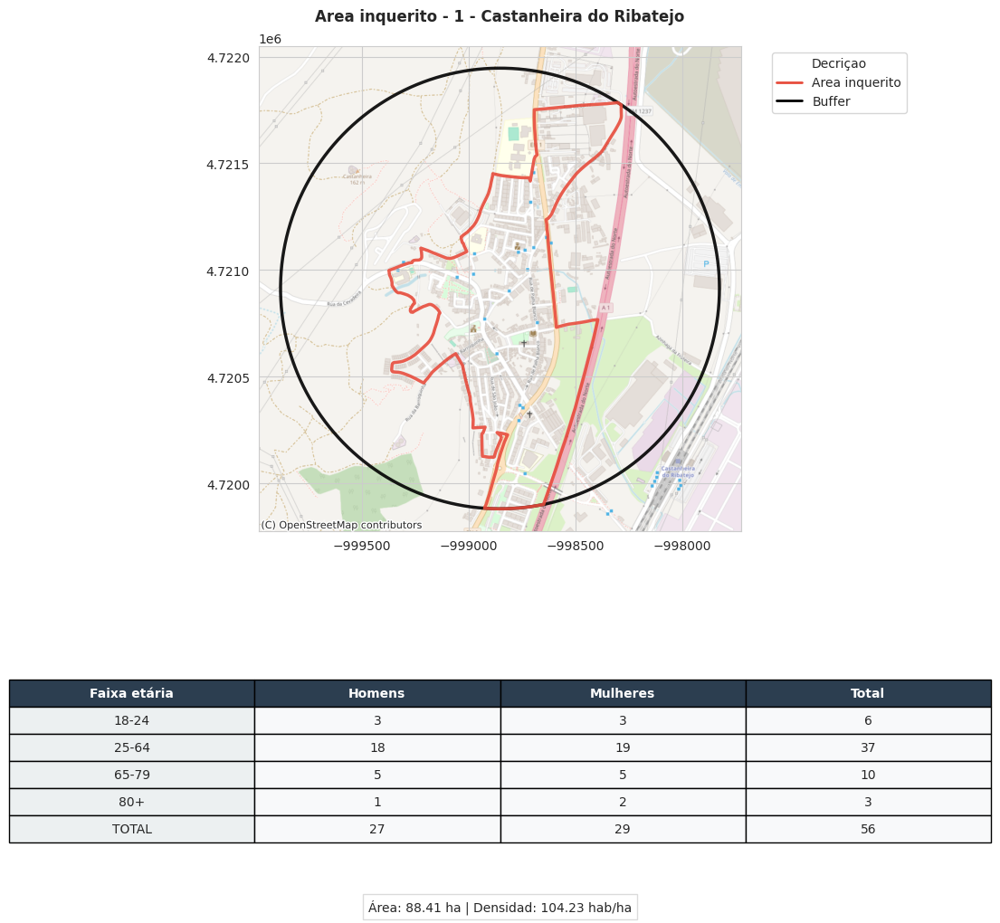

Mapa generado para intersection_0: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_0.png


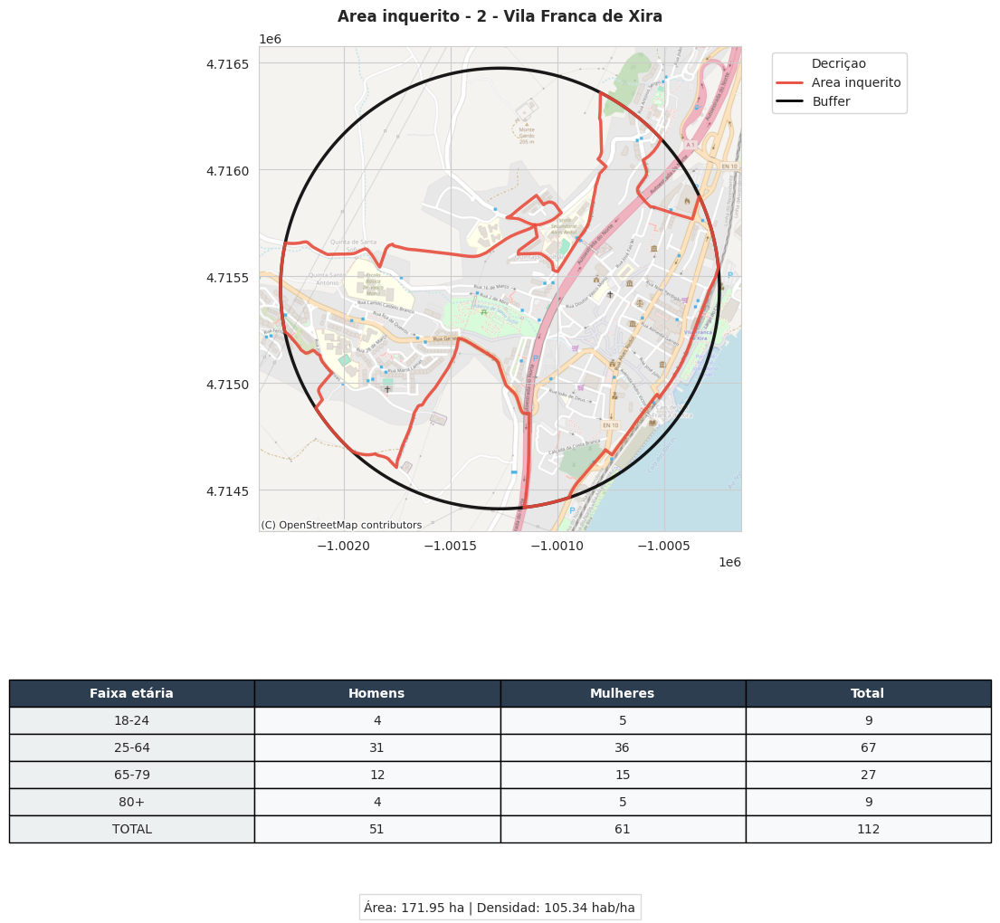

Mapa generado para intersection_1: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_1.png


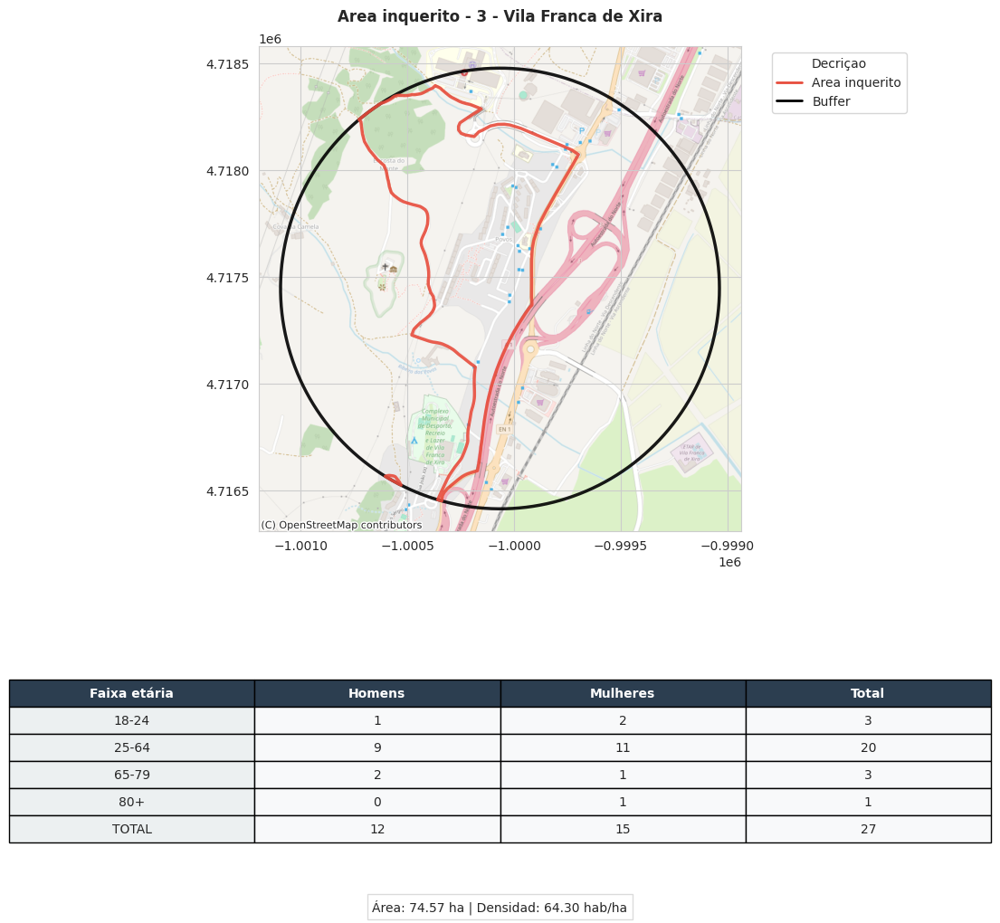

Mapa generado para intersection_2: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_2.png


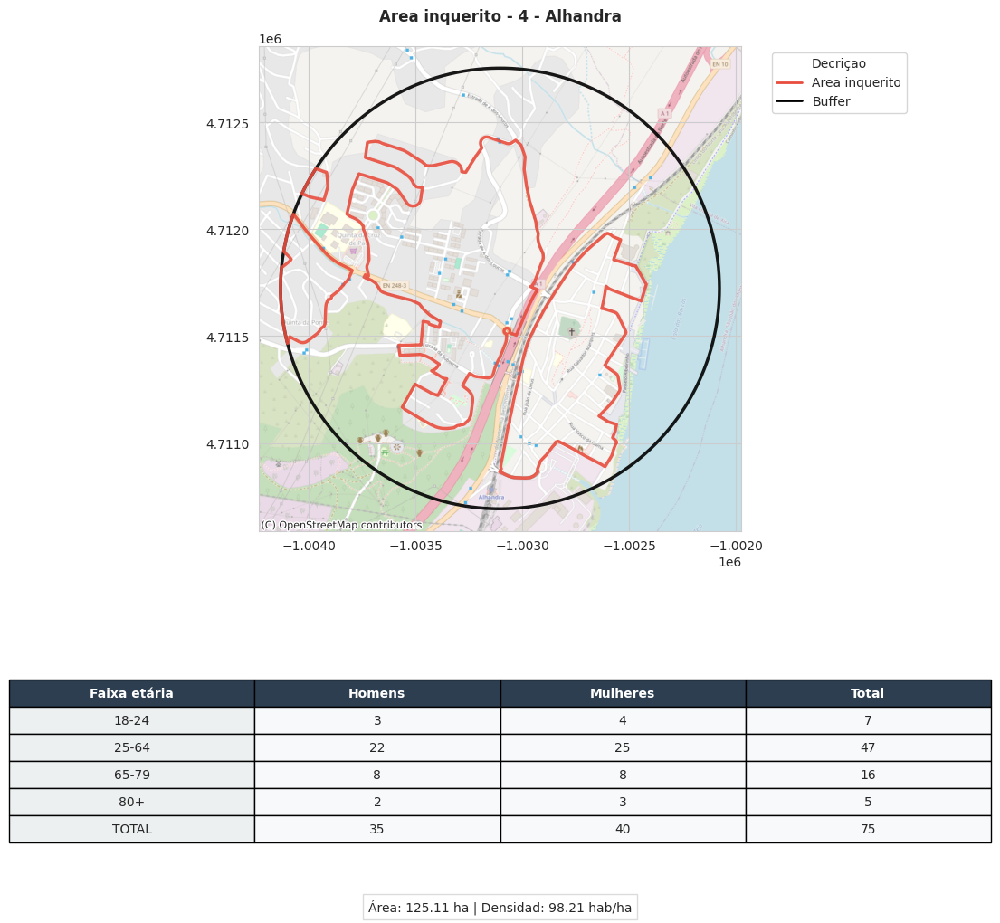

Mapa generado para intersection_3: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_3.png


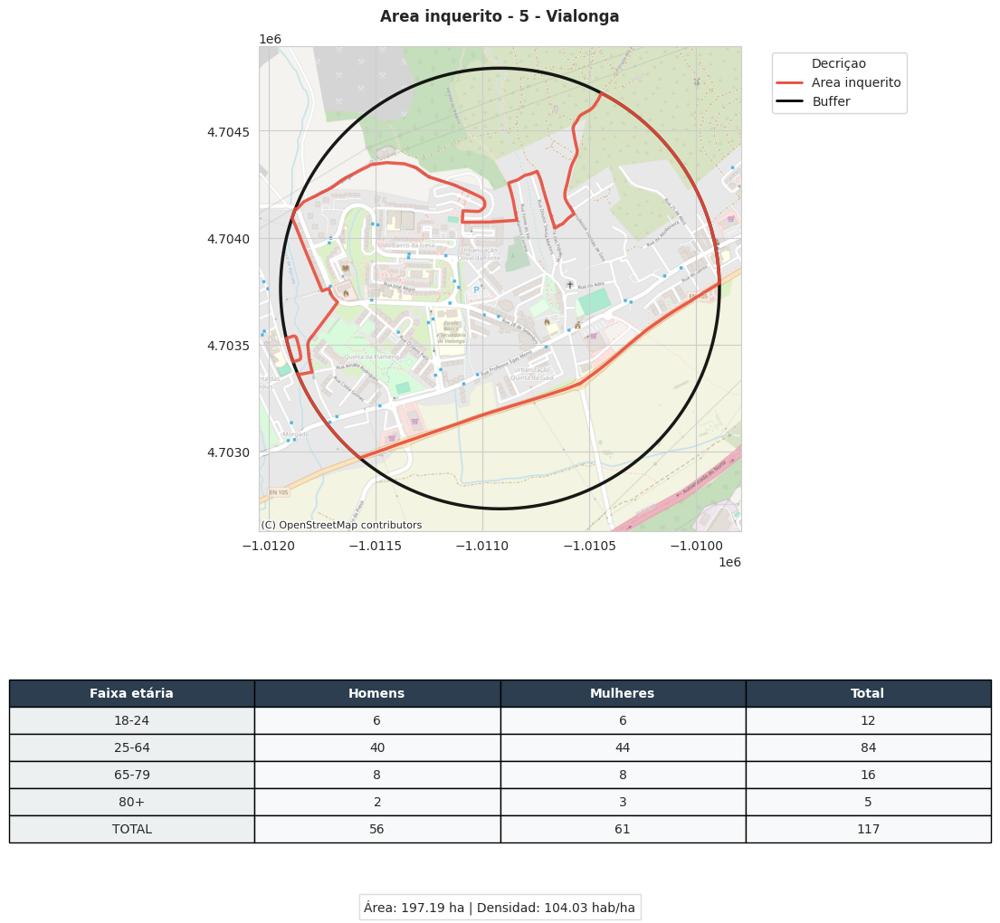

Mapa generado para intersection_4: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_4.png


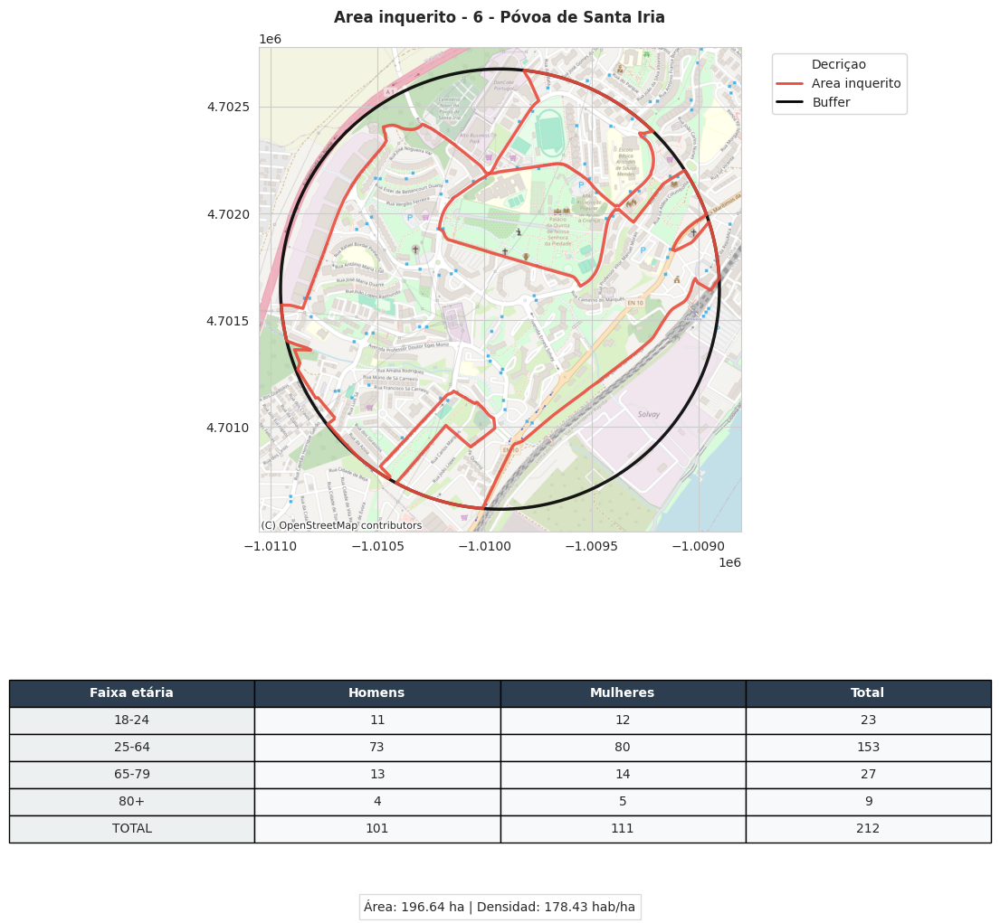

Mapa generado para intersection_5: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_5.png


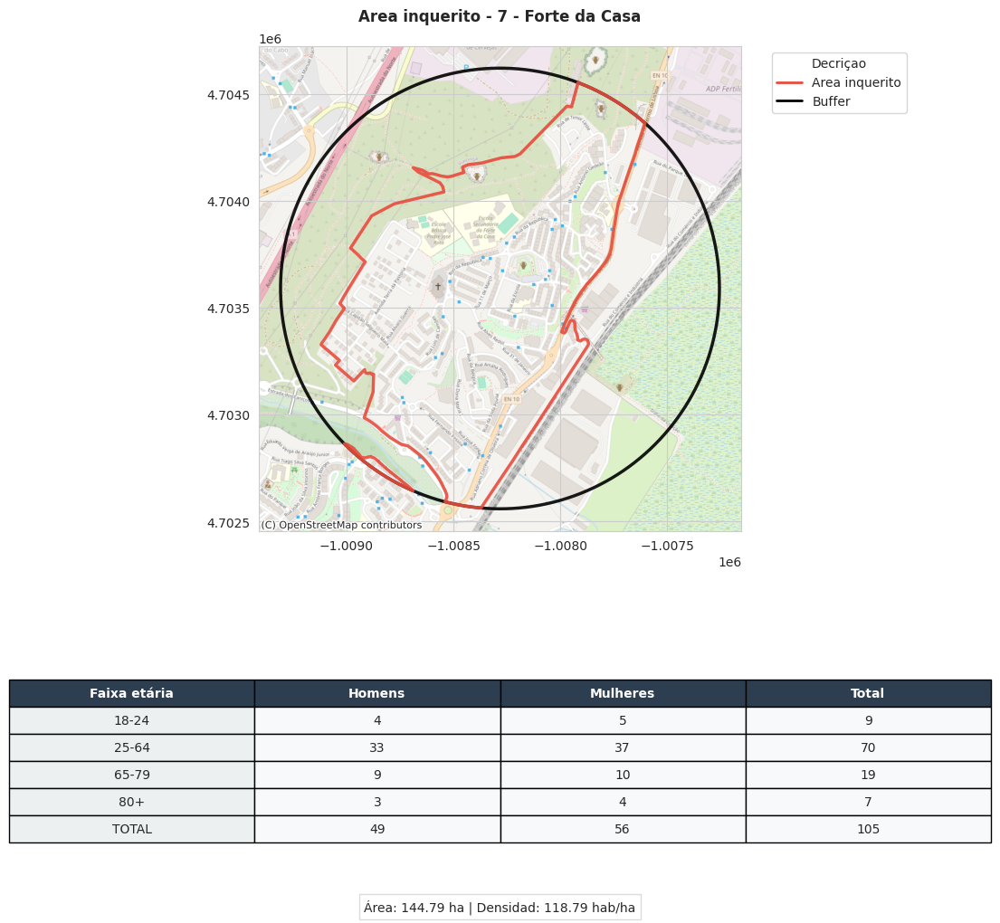

Mapa generado para intersection_6: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_6.png


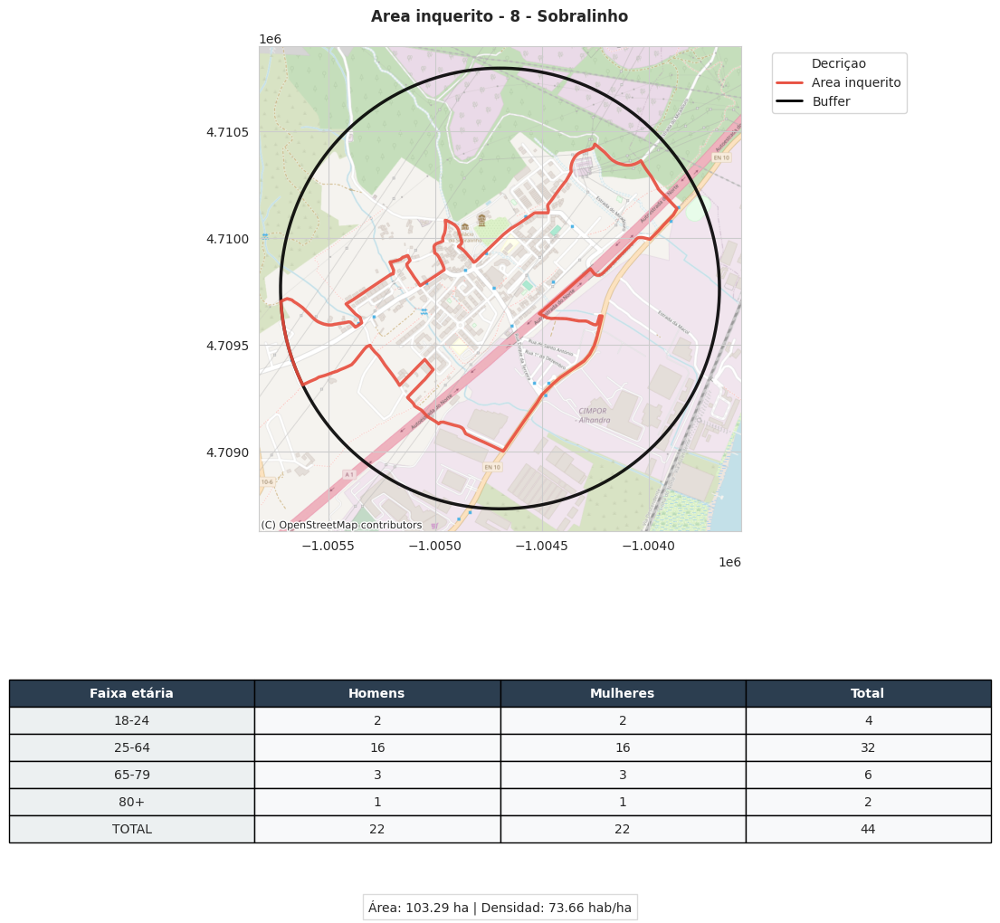

Mapa generado para intersection_7: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_7.png


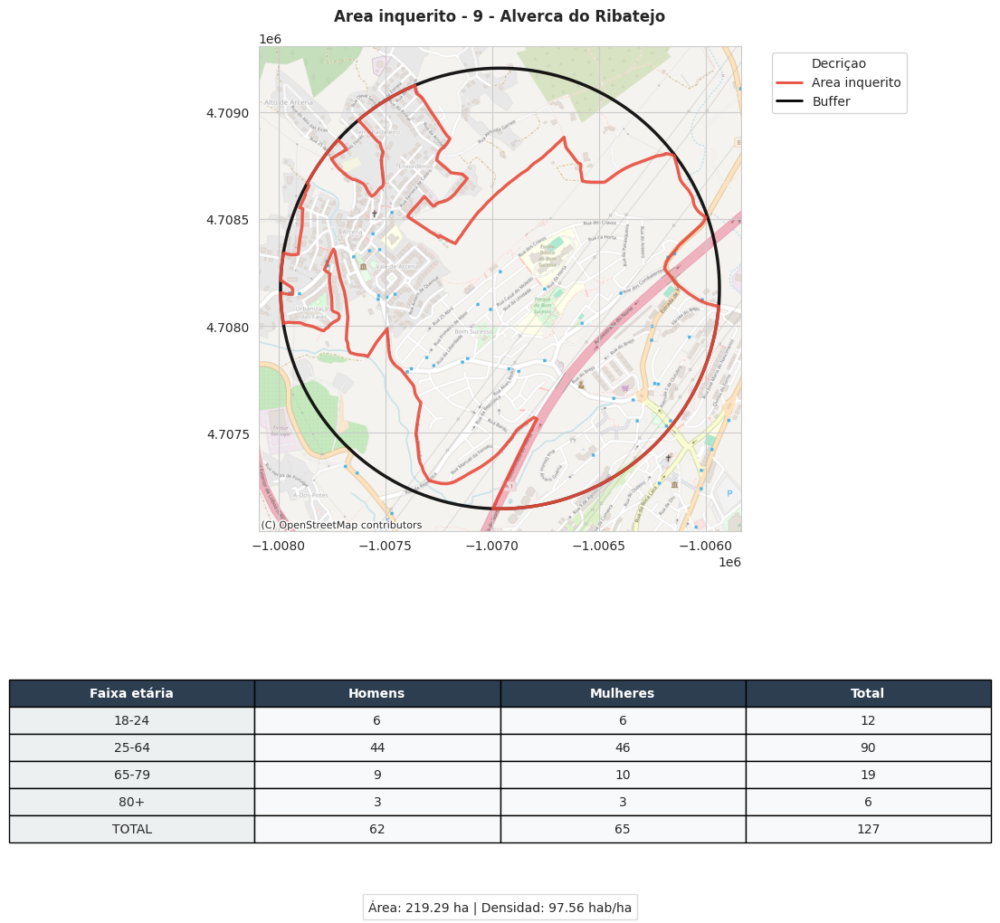

Mapa generado para intersection_8: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_8.png


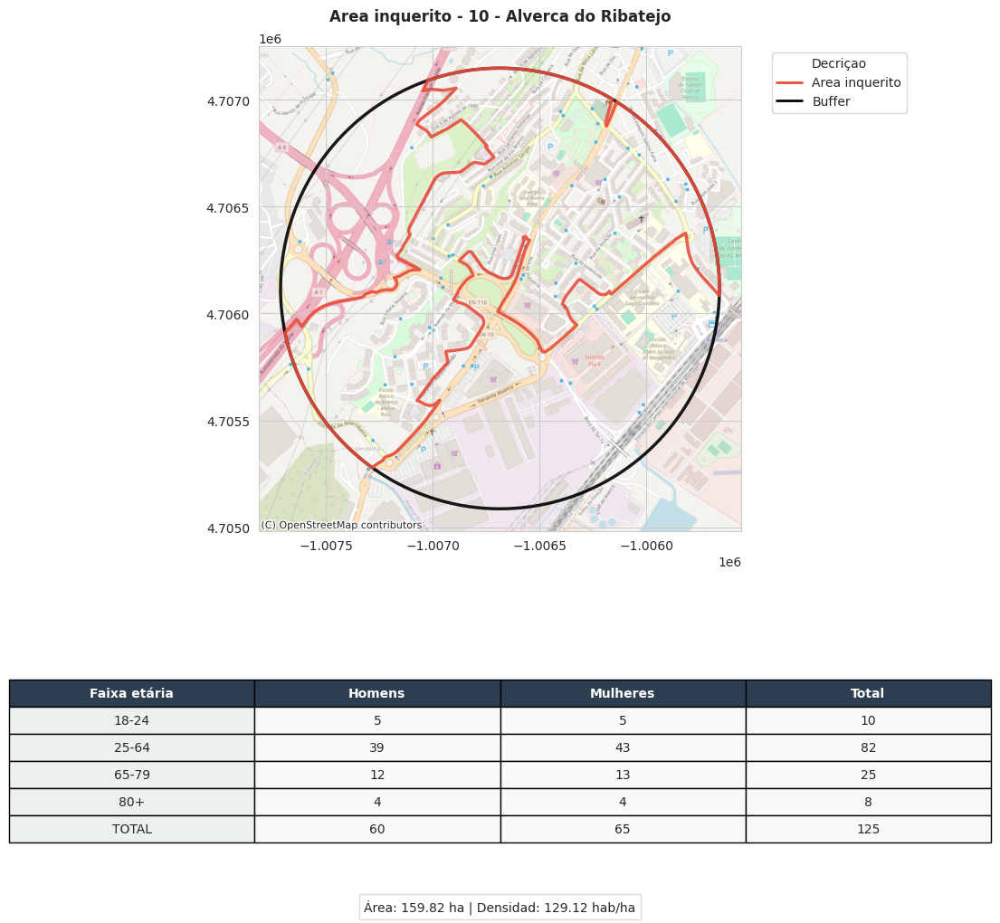

Mapa generado para intersection_9: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/intersection_9.png


In [27]:
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.font_manager import FontProperties
from io import StringIO
import seaborn as sns # Import Seaborn
from shapely.ops import unary_union



def generar_mapas_con_datos_especificos(aligned_buffers, df_datos, BASE_SAVE_PATH):
    """
    Genera mapas personalizados mostrando los datos específicos de cada intersección
    desde el dataset que proporcionaste.
    """
    # Configuración de estilos
    sns.set_style("whitegrid")  # Use Seaborn's style settings
    font_title = FontProperties(weight='bold', size=12)
    font_data = FontProperties(size=10)

    # Crear directorio si no existe
    os.makedirs(BASE_SAVE_PATH, exist_ok=True)
    imagenes_generadas = []

    for index, (nombre, data) in enumerate(aligned_buffers.items()):
        gdf = data['intersection_df']
        buffer_df = data['buffer_df']
        gdf = gdf.to_crs(epsg=3763)
        buffer_df = buffer_df.to_crs(epsg=3857)


        # Obtener datos específicos para este buffer
        datos_buffer = df_datos[df_datos['ID Buffer'] == nombre].iloc[0]

        # Calcular métricas adicionales
        total_hombres_inq = datos_buffer.filter(like='_H').sum()
        total_mujeres_inq = datos_buffer.filter(like='_M').sum()
        total_poblacion_inq = total_hombres_inq + total_mujeres_inq

        # Calcular métricas de densidad
        total_hombres = gdf['pobMen'].sum()
        total_mujeres = gdf['pobWMen'].sum()
        total_poblacion = total_hombres + total_mujeres
        densidad = total_poblacion / (gdf.geometry.area.sum() / 10000) if gdf.geometry.area.sum() > 0 else 0

        # Realizar la intersección
        intersection_name = f"intersection_{index}"
        #intersections[intersection_name] = gpd.overlay(VFX_P_filtered, buffers[buffer_name], how='intersection')
        #areas[intersection_name] = gpd.overlay(VFX, buffers[buffer_name], how='intersection')

        # Calcular la zona dominante por su área
        # ------------------------------------------
        # Obtener el índice del polígono con el área máxima
        dominant_index = areas[intersection_name].geometry.area.idxmax()

        # Si todas las áreas son 0, no hay zona dominante
        if areas[intersection_name].geometry.area.max() == 0:
            dominant_area_name = None
        else:
            # Si hay zonas con área, asignar el nombre de la zona dominante
            # (Asumiendo que VFX tiene una columna con nombres de zonas, ej: 'Zona')
           dominant_area_name = areas[intersection_name].loc[dominant_index, 'NAME'] if 'NAME' in areas[intersection_name].columns else None

        # Asignar el valor 'dominant_area' a la columna deseada
        areas[intersection_name]['dominant_age'] = dominant_area_name
        # ------------------------------------------

        # Si hay intersección, crear el mapa


        # Crear figura con dos partes: mapa y panel de datos
        fig = plt.figure(figsize=(14, 12))
        gs = fig.add_gridspec(2, 1, height_ratios=[2, 1], hspace=0.3)
        ax_map = fig.add_subplot(gs[0])
        ax_data = fig.add_subplot(gs[1])
        ax_data.axis('off')

        # ===== PARTE SUPERIOR: MAPA =====
        # 3. Graficar el mapa
        # Mapa de densidad
        gdf = gdf.to_crs(epsg=3857)
        # Hacer merge de todos los polígonos en uno solo
        mergede_gdf = unary_union(gdf.geometry)
        # Obtener solo el exterior (borde) del polígono mergeado
        if mergede_gdf.geom_type == 'MultiPolygon':
            # Para MultiPolígonos, tomamos el exterior de cada componente
            exterior_geom = [poly.exterior for poly in mergede_gdf.geoms]
        else:
            # Para un solo polígono
            exterior_geom = [mergede_gdf.exterior]

        # Crear GeoDataFrame con el/los bordes
        merged_gdf = gpd.GeoDataFrame(geometry=exterior_geom, crs=gdf.crs)

        #merged_gdf = gpd.GeoDataFrame(geometry=[mergede_gdf], crs=gdf.crs)

        merged_gdf.plot(
            ax=ax_map,
            facecolor='none',          # Sin relleno
            edgecolor='#e74c3c',       # Color rojo para contornos
            linewidth=2.5,             # Grosor de línea
            alpha=0.9
        )

        # Buffer
        buffer_df.plot(
            ax=ax_map,
            color='none',
            edgecolor='black',
            linewidth=2.5,
            alpha=0.9
        )

        # Base map
        ctx.add_basemap(
            ax_map,
            crs=buffer_df.crs.to_string(),
            source=ctx.providers.OpenStreetMap.Mapnik,
            alpha=0.7
        )

        # Leyenda unificada
        legend_elements = [
        Line2D([0], [0], color='#e74c3c', lw=2, label='Area inquerito'),
        Line2D([0], [0], color='black', lw=2, label='Buffer')
        ]

        ax_map.legend(handles=legend_elements,
              title='Decriçao',
              bbox_to_anchor=(1.05, 1),
              loc='upper left')
        ax_map.set_title(
            #f"Intersección {index}: Densidad (ha)\nBuffer {index} {dominant_area_name}
            f"Area inquerito - {index+1} - {dominant_area_name}",
            fontproperties=font_title,
            pad=20
        )

        # ===== PARTE INFERIOR: PANEL DE DATOS =====
        # Organizar los datos en grupos
        grupos_edad = ['18-24', '25-64', '65-79', '80+']
        datos_organizados = []

        for grupo in grupos_edad:
            h = datos_buffer[f"{grupo}_H"]
            m = datos_buffer[f"{grupo}_M"]
            datos_organizados.append([grupo, h, m, h + m])

        # Totales
        datos_organizados.append(["TOTAL", total_hombres_inq, total_mujeres_inq, total_poblacion_inq])

        # Crear tabla
        tabla = ax_data.table(
            cellText=datos_organizados,
            colLabels=["Faixa etária", "Homens", "Mulheres", "Total"],
            loc='center',
            cellLoc='center',
            colColours=['#f7f7f7']*4
        )

        # Formato de la tabla
        tabla.auto_set_font_size(False)
        tabla.set_fontsize(10)
        tabla.scale(1, 1.8)

        # Estilo celdas
        for (i, j), cell in tabla.get_celld().items():
            if i == 0:  # Encabezados
                cell.set_facecolor('#2c3e50')
                cell.set_text_props(color='white', weight='bold')
            elif j == 0:  # Columna grupo edad
                cell.set_facecolor('#ecf0f1')
            else:
                cell.set_facecolor('#f8f9fa')

        # Información adicional
        info_extra = f"Área: {gdf.geometry.area.sum()/10000:.2f} ha | Densidad: {densidad:.2f} hab/ha"
        ax_data.text(
            0.5, -0.1, info_extra,
            ha='center', va='center',
            fontproperties=font_data,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='lightgray')
        )
        filename = f"{nombre}.png".replace(" ", "_").replace("/", "-")
        save_path = os.path.join(BASE_SAVE_PATH, filename)
        if save_path:
                      os.makedirs(os.path.dirname(save_path), exist_ok=True)
                      plt.savefig(save_path, dpi=300, bbox_inches='tight')
                      plt.savefig(save_path.replace('.png', '.pdf'), format='pdf', bbox_inches='tight')
                      plt.savefig(save_path.replace('.png', '.svg'), format='svg', bbox_inches='tight')
                #print(f"Imagen guardada en: {save_path}")
        plt.show()
        plt.close()

        print(f"Mapa generado para {nombre}: {save_path}")

    return imagenes_generadas

# Ejemplo de uso:
# 1. Cargar tu dataset (si no lo tienes ya en memoria)
# Datos de la tabla en formato de texto
tabla_texto = """
ID Buffer	18-24_H	18-24_M	25-64_H	25-64_M	65-79_H	65-79_M	80+_H	80+_M
intersection_0	3	3	18	19	5	5	1	2
intersection_1	4	5	31	36	12	15	4	5
intersection_2	1	2	9	11	2	1	0	1
intersection_3	3	4	22	25	8	8	2	3
intersection_4	6	6	40	44	8	8	2	3
intersection_5	11	12	73	80	13	14	4	5
intersection_6	4	5	33	37	9	10	3	4
intersection_7	2	2	16	16	3	3	1	1
intersection_8	6	6	44	46	9	10	3	3
intersection_9	5	5	39	43	12	13	4	4
"""

# Crear DataFrame desde el texto
df_datos = pd.read_csv(StringIO(tabla_texto), sep='\t')

# df_datos = pd.read_csv('tu_dataset.csv')
BASE_SAVE_PATH = "/content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_1/"  # Usa / en lugar de \ en Windows

# 2. Generar los mapas
mapas_con_datos = generar_mapas_con_datos_especificos(aligned_buffers, df_datos, BASE_SAVE_PATH)

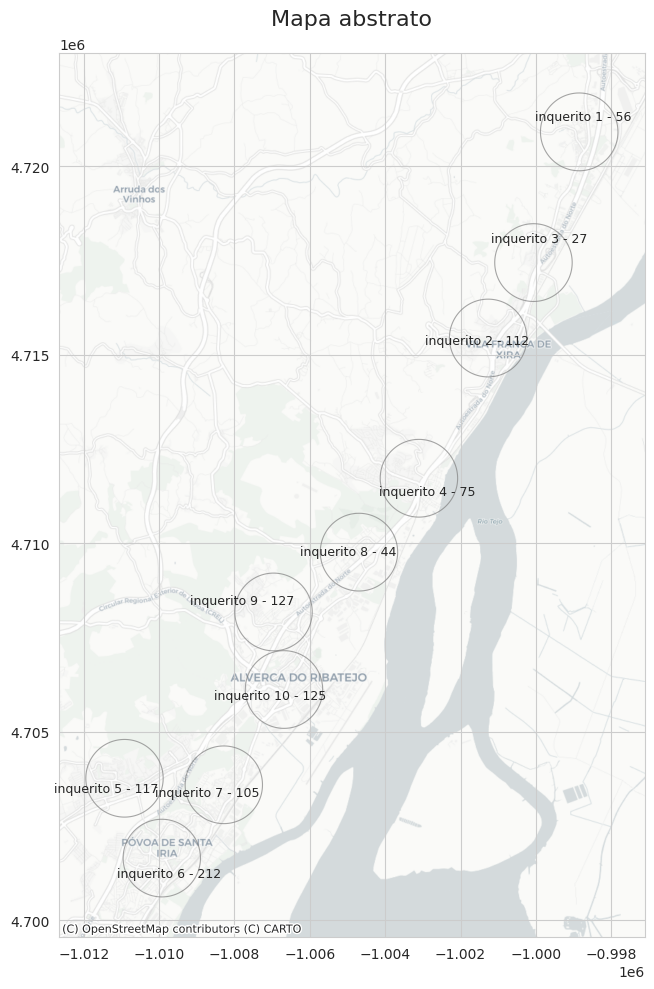

Mapa combinado guardado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final/mapa_abstracto.png


In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import os
import contextily as ctx
from matplotlib.font_manager import FontProperties
from io import StringIO
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap

# ... (previous code remains the same)

def generar_mapa_combinado(aligned_buffers, df_datos, BASE_SAVE_PATH):
    """Genera un único mapa con todos los datos en una sola visualización"""
    sns.set_style("whitegrid")
    font_title = FontProperties(weight='bold', size=12)
    font_data = FontProperties(size=10)
    os.makedirs(BASE_SAVE_PATH, exist_ok=True)
    i = 0
    fig, ax = plt.subplots(figsize=(16, 10))

    for nombre, data in aligned_buffers.items():
        gdf = data['intersection_df']
        buffer_df = data['buffer_df']

        # Reproyectar para la visualización
        gdf = gdf.to_crs(epsg=3857)
        buffer_df = buffer_df.to_crs(epsg=3857)

        # Graficar el buffer
        buffer_df.plot(ax=ax, color='none', edgecolor='gray', linewidth=0.8, alpha=0.7)

        # Datos de la tabla
        datos_buffer = df_datos[df_datos['ID Buffer'] == nombre].iloc[0]
        total_poblacion = datos_buffer.filter(like='_H').sum() + datos_buffer.filter(like='_M').sum()
        i=i+1
        # Etiquetas con información
        centroid = gdf.geometry.centroid.iloc[0]
        ax.text(centroid.x, centroid.y, f"inquerito {i} - {total_poblacion}", fontsize=9, ha='center', va='center')

    # Agregar basemap
    ctx.add_basemap(ax, crs=buffer_df.crs.to_string(), source=ctx.providers.CartoDB.Positron)


    ax.set_title("Mapa abstrato", fontsize=16, pad=20)
    plt.tight_layout()
    img_path = os.path.join(BASE_SAVE_PATH, f"mapa_abstracto.png")
    plt.savefig(img_path, dpi=300, bbox_inches="tight")
    plt.savefig(img_path.replace(".png", ".pdf"), format="pdf", bbox_inches="tight")
    plt.savefig(img_path.replace(".png", ".svg"), format="svg", bbox_inches="tight")
    plt.show()
    plt.close()

    print(f"Mapa combinado guardado: {img_path}")


# Ejemplo de uso (recuerda tener df_datos y aligned_buffers)

# ... (código previo)

# Llamada a la función para generar el mapa combinado
generar_mapa_combinado(aligned_buffers, df_datos, BASE_SAVE_PATH)


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
from matplotlib.font_manager import FontProperties
import seaborn as sns
import contextily as ctx
from matplotlib.lines import Line2D
from shapely.ops import unary_union
import os
from io import StringIO

def generar_mapas_borde_externo(aligned_buffers, df_datos, areas, BASE_SAVE_PATH):
    """
    Genera mapas mostrando solo el borde externo del merge de polígonos
    """
    # Configuración de estilos
    sns.set_style("whitegrid")
    font_title = FontProperties(weight='bold', size=12)
    font_data = FontProperties(size=10)

    # Crear directorio si no existe
    os.makedirs(BASE_SAVE_PATH, exist_ok=True)
    imagenes_generadas = []

    for index, (nombre, data) in enumerate(aligned_buffers.items()):
        gdf = data['intersection_df']
        buffer_df = data['buffer_df']

        # Convertir CRS
        gdf = gdf.to_crs(epsg=3763)
        buffer_df = buffer_df.to_crs(epsg=3857)

        # 1. Crear el borde externo del merge
        merged_geom = unary_union(gdf.geometry)

        # Obtener solo el exterior (borde) del polígono mergeado
        if merged_geom.geom_type == 'MultiPolygon':
            # Para MultiPolígonos, tomamos el exterior de cada componente
            exterior_geom = [poly.exterior for poly in merged_geom.geoms]
        else:
            # Para un solo polígono
            exterior_geom = [merged_geom.exterior]

        # Crear GeoDataFrame con el/los bordes
        border_gdf = gpd.GeoDataFrame(geometry=exterior_geom, crs=gdf.crs)

        # 2. Obtener datos demográficos
        datos_buffer = df_datos[df_datos['ID Buffer'] == nombre].iloc[0]

        # Calcular métricas
        total_hombres = datos_buffer.filter(like='_H').sum()
        total_mujeres = datos_buffer.filter(like='_M').sum()
        total_poblacion = total_hombres + total_mujeres
        area = gdf.geometry.area.sum() / 10000  # Hectáreas
        densidad = total_poblacion / area if area > 0 else 0

        # Obtener nombre de área dominante
        dominant_index = areas[f"intersection_{index}"].geometry.area.idxmax()
        dominant_area_name = areas[f"intersection_{index}"].loc[dominant_index, 'NAME'] if 'NAME' in areas[f"intersection_{index}"].columns else None

        # 3. Crear figura
        fig = plt.figure(figsize=(14, 12))
        gs = fig.add_gridspec(2, 1, height_ratios=[2, 1], hspace=0.3)
        ax_map = fig.add_subplot(gs[0])
        ax_data = fig.add_subplot(gs[1])
        ax_data.axis('off')

        # ===== PARTE SUPERIOR: MAPA =====
        # Mapa base
        ctx.add_basemap(
            ax_map,
            crs=buffer_df.crs.to_string(),
            source=ctx.providers.CartoDB.Positron,
            alpha=0.9
        )

        # Graficar solo el borde externo
        border_gdf.plot(
            ax=ax_map,
            facecolor='none',
            edgecolor='#e74c3c',  # Rojo
            linewidth=2.5,
            alpha=0.9
        )

        # Buffer
        buffer_df.plot(
            ax=ax_map,
            color='none',
            edgecolor='#3498db',  # Azul
            linewidth=2,
            linestyle='--',
            alpha=0.8
        )

        # Leyenda
        legend_elements = [
            Line2D([0], [0], color='#e74c3c', lw=2, label='Área de estudio (borde externo)'),
            Line2D([0], [0], color='#3498db', lw=2, linestyle='--', label='Buffer')
        ]

        ax_map.legend(
            handles=legend_elements,
            loc='upper right',
            framealpha=1
        )

        ax_map.set_title(
            f"Área de Estudio {index+1}: {dominant_area_name}",
            fontproperties=font_title,
            pad=20
        )

        # ===== PARTE INFERIOR: TABLA DE DATOS =====
        grupos_edad = ['18-24', '25-64', '65-79', '80+']
        datos_tabla = []

        for grupo in grupos_edad:
            h = datos_buffer[f"{grupo}_H"]
            m = datos_buffer[f"{grupo}_M"]
            datos_tabla.append([grupo, h, m, h + m])

        # Totales
        datos_tabla.append(["TOTAL", total_hombres, total_mujeres, total_poblacion])

        # Crear tabla
        tabla = ax_data.table(
            cellText=datos_tabla,
            colLabels=["Faixa etária", "Homens", "Mulheres", "Total"],
            loc='center',
            cellLoc='center',
            colColours=['#f7f7f7']*4
        )

        # Formato tabla
        tabla.auto_set_font_size(False)
        tabla.set_fontsize(10)
        tabla.scale(1, 1.8)

        # Estilo celdas
        for (i, j), cell in tabla.get_celld().items():
            if i == 0:  # Encabezados
                cell.set_facecolor('#2c3e50')
                cell.set_text_props(color='white', weight='bold')
            elif j == 0:  # Columna grupo edad
                cell.set_facecolor('#ecf0f1')
            else:
                cell.set_facecolor('#f8f9fa')

        # Información adicional
        info_extra = f"Área: {area:.2f} ha | Densidad: {densidad:.2f} hab/ha"
        ax_data.text(
            0.5, -0.1, info_extra,
            ha='center', va='center',
            fontproperties=font_data,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='lightgray')
        )

        # Guardar imagen
        filename = f"mapa_borde_externo_{nombre}.png".replace(" ", "_")
        save_path = os.path.join(BASE_SAVE_PATH, filename)

        plt.savefig(save_path, dpi=300, bbox_inches='tight', facecolor='white')
        plt.savefig(save_path.replace('.png', '.pdf'), format='pdf', bbox_inches='tight')
        plt.savefig(save_path.replace('.png', '.svg'), format='svg', bbox_inches='tight')

        plt.close()
        imagenes_generadas.append(save_path)
        print(f"Mapa generado: {save_path}")

    return imagenes_generadas

# Ejemplo de uso

tabla_texto = """
ID Buffer	18-24_H	18-24_M	25-64_H	25-64_M	65-79_H	65-79_M	80+_H	80+_M
intersection_0	3	3	18	19	5	5	1	2
intersection_1	4	5	31	36	12	15	4	5
intersection_2	1	2	9	11	2	1	0	1
intersection_3	3	4	22	25	8	8	2	3
intersection_4	6	6	40	44	8	8	2	3
intersection_5	11	12	73	80	13	14	4	5
intersection_6	4	5	33	37	9	10	3	4
intersection_7	2	2	16	16	3	3	1	1
intersection_8	6	6	44	46	9	10	3	3
intersection_9	5	5	39	43	12	13	4	4
"""

# Crear DataFrame desde el texto
df_datos = pd.read_csv(StringIO(tabla_texto), sep='\t')

# df_datos = pd.read_csv('tu_dataset.csv')
BASE_SAVE_PATH = "/content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/"  # Usa / en lugar de \ en Windows

mapas_borde_externo = generar_mapas_borde_externo(aligned_buffers, df_datos, areas, BASE_SAVE_PATH)

/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_0.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_1.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_2.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_3.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_4.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_5.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_6.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_7.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_8.png


/usr/local/lib/python3.11/dist-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).
  warnings.warn(msg)


Mapa generado: /content/drive/MyDrive/PhD/Survey/VFX_buffer/Maps_final_2/mapa_borde_externo_intersection_9.png
